# Crime in Boston - Group #14

In [77]:
from functools import reduce
from datetime import date, datetime
import time

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import folium
from folium.plugins import HeatMap, DualMap
import seaborn as sns
import geopy.distance
import plotly.express as px
import plotly.io as pio
import numpy as np
import pandas as pd
import dask.dataframe as dd
import holidays

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import accuracy_score, roc_curve
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.utils import resample
from sklearn.metrics import f1_score, roc_auc_score, confusion_matrix, classification_report
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.preprocessing import StandardScaler

from imblearn.under_sampling import RandomUnderSampler
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import SMOTE

import eli5
from eli5.sklearn import PermutationImportance

import lime
from lime.lime_tabular import LimeTabularExplainer

import CombineDataSource as util

%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

# pandas tricks for better display
pd.set_option('display.width', 1500)
pd.set_option('display.max_columns', 100)

## Initial data combining , feature engineering, and data reconcilation

Below datasets are used as part of this initial analysis:

**Primary dataset**
- Boston crime data (2015 -2021)
<br>

**Secondary dataset**
- Neighborhood data (Demographic and Socio-economic data points)
- Weather Dataset
- Street light locations dataset

We combined all the crime incident report from 2015-2021;  For more granularity we included neighborhood feature to each of the incident, and we added weather and socio-economic information based on each neighborhood.


In [2]:
data_tracking_dict = {"data_source":["crime_incident_report", "Neighborhood", "Weather_socio_economic", "streetlight", "additional_info", "crime_type"], "total_rows":[],"total_columns":[]  }

df = util.combineCrimeIncidentReport()
data_tracking_dict['total_rows'].append(df.shape[0])
data_tracking_dict['total_columns'].append(df.shape[1])

df = util.appendNeighborhood(df)
data_tracking_dict['total_rows'].append(df.shape[0])
data_tracking_dict['total_columns'].append(df.shape[1])

df = util.appendWeatherAndNeigborhoodData(df)
data_tracking_dict['total_rows'].append(df.shape[0])
data_tracking_dict['total_columns'].append(df.shape[1])

# Add street light info
stlt_distance_df = pd.read_csv("data/boston/street_light_distance.csv")
df = df.merge(stlt_distance_df[["Location", 'stlt_distance']], on = "Location", how ="left")
data_tracking_dict['total_rows'].append(df.shape[0])
data_tracking_dict['total_columns'].append(df.shape[1])

# Additional demographic data
additional_info_df = pd.read_csv("data/boston/additional_demographic_info.csv")
df = df.merge(additional_info_df, on = "neighborhood", how="left")
data_tracking_dict['total_rows'].append(df.shape[0])
data_tracking_dict['total_columns'].append(df.shape[1])

### Response variable

The crime data until 2018 had column called UCR_PART that categorized the crimes using FBI’s Uniform Crime Reporting Handbook. The UCR has more violent PART_1 category that includes murder, rape, theft etc. and PART_2 category that includes less violent crimes such as fraud, forgery, drug related crimes etc. The pre-2018 Boston data had also PART_3 and ‘other’ for incidents that did not fall under those two categories (e.g., sick calls). We created a list of keywords and new column called crime_type and assigned all the incidents a type of 1, 2, or 3 based on FBI definition and Boston crime data.

In [3]:
# categorize crime based on FBI and the data that has categories for some years. 
# The data has "part_3" and "other", we assign everything that is not part 1 or part 2 to category 3

df_merged_with_categories = df.copy()

# NOTE: 'assalut' represent non-aggravated type
part_2 = ['assault', 'Forgery', 'fraud', 'Embezzlement', 'Vandalism', 'weapon', 'Prostitution', 'prostitute','sex', 
          'stolen', 'drug', 'gambling', 'Liquor', 'child', 'drunk', 'Disorderly', 'Suspicion', 'offense',
         'Loitering', 'runaway', 'A&B', 'ABDUCTION', 'affray', 'abuse', 'annoying', 'ballistics', 'bomb', 'chins',
         'consipiracy', 'minor', 'counterfeiting', 'harassment', 'disturbing', 'kidnapping', 'evading', 'explosive',
         'extortion', 'fugitive', 'alcohol', 'obscene', 'graffiti', 'escape', 'burglarious', 'threats',
         'trespassing', 'val', 'viol', 'prisoner', 'stalking', 'confidence'] # needs to be before part_1 so aggregated assult is assigned correctly


# NOTE: 'aggravated' will capture aggravated assault type as part of Part I
part_1 = ['homicide', 'rape', 'robbery', 'aggravated', 'Burglary', 'Larceny', 'theft', 'arson', 'MURDER', 'B&E']


# Assign crime type as Part III by default, and subsequent code will refine it (for part I and part II)
df_merged_with_categories['crime_type'] = 3

# Assign 
df_merged_with_categories.loc[df_merged_with_categories['UCR_PART']=='Part One', "crime_type"] = 1
df_merged_with_categories.loc[df_merged_with_categories['UCR_PART']=='Part Two', "crime_type"] = 2

df_merged_with_categories.loc[(df_merged_with_categories['OFFENSE_DESCRIPTION'].str.contains('|'.join(part_2), case=False)) & (df_merged_with_categories['UCR_PART'].isna()), "crime_type"] = 2
df_merged_with_categories.loc[(df_merged_with_categories['OFFENSE_DESCRIPTION'].str.contains('|'.join(part_1), case=False)) & (df_merged_with_categories['UCR_PART'].isna()), "crime_type"] = 1


df_merged_with_categories.groupby('crime_type').size()
df = df_merged_with_categories.copy()

data_tracking_dict['total_rows'].append(df.shape[0])
data_tracking_dict['total_columns'].append(df.shape[1])


### DataFrame stats after combining data source, and feature engineering

We started with our primary dataset with 552101 rows, and 17 features. For each observation we added the Neighborhood feature for more granularity compared to district level information.  Adding the Weather and Socio Economic data gave us additional features. 

In [4]:
data_tracking_df = pd.DataFrame(data_tracking_dict)    
print("\n\nOur final dataframe after combining all the datasets, and features:")
display(data_tracking_df)
print("\n\n")



Our final dataframe after combining all the datasets, and features:


,data_source,total_rows,total_columns
0,crime_incident_report,552101,17
1,Neighborhood,552101,18
2,Weather_socio_economic,552101,60
3,streetlight,552101,61
4,additional_info,552101,76
5,crime_type,552101,77


In [5]:
print("Our dataframe's head:\n")
display(df.head())

Our dataframe's head:



,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location,neighborhood,AWND,PRCP,SNOW,TAVG,TMAX,TMIN,district,population,income,income_per_capita,median_household_income,0_15_housholds,15_25_housholds,25_35_housholds,35_50_housholds,50_75_housholds,75_100_housholds,100_150_housholds,150_plus_housholds,population_over_25,less_than_hs,highschool,some_college,bachelor,master_above,total_housing_units,total_housing_occupied,housing_owner_occupied,housing_renter_occupied,native_born_citizens,citizents_naturalization,non_citizen,mgm_buss_art_sci,service,sales_office,nr_const_maint,prod_trans_mat,white,black,hispanic,asian,other_race,stlt_distance,labor_overall,labor_16_19,labor_20_34,labor_35_64,labor_65,travel_time_0_29,travel_time_30_59,travel_time_60,poverty_rate,boston_impoverished,married_couple,male_household_no_spouse,female_household_no_spouse,living_alone,not_living_alone,crime_type
0,I192068249,2647,Other,THREATS TO DO BODILY HARM,B2,280,NaN,2015-08-28,2015,8,Friday,10,Part Two,WASHINGTON ST,42.330119,-71.084251,"(42.33011862, -71.08425106)",Roxbury,7.61,0.00,0.0,70.0,75.0,64.0,B2,54161.0,1.136173e+09,20978.0,30534.0,6340.0,2449.0,2084.0,2216.0,2107.0,1581.0,1806.0,1316.0,33588.0,7733.0,9902.0,8273.0,5048.0,2632.0,21699.0,19899.0,4326.0,15573.0,38707.0,8537.0,6917.0,7785.0,6702.0,5093.0,985.0,2851.0,5937.0,27243.0,16637.0,1905.0,2439.0,7.06,0.615,0.4854,0.7313,0.7022,0.1712,0.4102,0.4596,0.1302,0.3169,0.1327,0.1777,0.0619,0.3095,0.3709,0.0800,2
1,I192061894,1106,Confidence Games,FRAUD - CREDIT CARD / ATM FRAUD,C11,356,NaN,2015-08-20,2015,8,Thursday,0,Part Two,CHARLES ST,42.300605,-71.061268,"(42.30060543, -71.06126785)",Dorchester,10.74,0.00,0.0,73.0,78.0,68.0,C11,126909.0,3.777727e+09,29767.0,55009.0,8042.0,4694.0,3464.0,4581.0,6121.0,4776.0,6324.0,6299.0,86012.0,15449.0,25697.0,19657.0,16095.0,9114.0,48868.0,44301.0,16005.0,28296.0,84520.0,24331.0,18058.0,22302.0,17578.0,13665.0,3987.0,6984.0,28244.0,55787.0,25288.0,12540.0,5050.0,30.96,0.690,0.3964,0.8408,0.7826,0.1874,0.3785,0.4525,0.1689,0.2222,0.2310,0.2656,0.0673,0.2701,0.2902,0.1068,2
2,I192038828,1107,Fraud,FRAUD - IMPERSONATION,A1,172,NaN,2015-11-02,2015,11,Monday,12,Part Two,ALBANY ST,42.334288,-71.072395,"(42.33428841, -71.07239518)",Downtown,7.16,0.00,0.0,57.0,64.0,51.0,A1,18306.0,1.465530e+09,80057.0,88750.0,1531.0,517.0,405.0,464.0,790.0,480.0,867.0,2888.0,12722.0,1963.0,1345.0,1399.0,3327.0,4688.0,9966.0,7942.0,2138.0,5804.0,11667.0,3034.0,3605.0,6318.0,1281.0,1597.0,98.0,380.0,10172.0,730.0,1100.0,5701.0,603.0,9.67,0.627,0.4345,0.7486,0.8011,0.1854,0.7414,0.2133,0.0453,0.2113,0.0263,0.3576,0.0219,0.0403,0.4584,0.1218,2
3,I192008877,1107,Fraud,FRAUD - IMPERSONATION,E18,525,NaN,2015-07-31,2015,7,Friday,10,Part Two,WINGATE RD,42.237009,-71.129566,"(42.23700950, -71.12956606)",Hyde Park,11.18,0.00,0.0,80.0,89.0,73.0,E18,38924.0,1.274531e+09,32744.0,72953.0,1805.0,1043.0,757.0,1058.0,2110.0,1605.0,2431.0,2338.0,27240.0,3759.0,7550.0,8210.0,5017.0,2704.0,13752.0,13147.0,7832.0,5315.0,26696.0,7662.0,4566.0,7365.0,4824.0,4339.0,1272.0,2414.0,8719.0,18042.0,10242.0,763.0,1158.0,150.54,0.699,0.3500,0.8518,0.8306,0.2039,0.3233,0.4739,0.2027,0.1492,0.0473,0.3843,0.0597,0.2678,0.2284,0.0597,2
4,I182090828,1102,Fraud,FRAUD - FALSE PRETENSE / SCHEME,D4,159,NaN,2015-12-01,2015,12,Tuesday,12,Part Two,UPTON ST,42.342432,-71.072258,"(42.34243222, -71.07225766)",South End,6.04,0.14,0.0,38.0,45.0,32.0,D4,32571.0,2.723215e+09,83609.0,86950.0,2882.0,1403.0,913.0,933.0,1790.0,1022.0,1833.0,6043.0,26302.0,3094.0,2927.0,3029.0,7741.0,9511.0,18296.0,16819.0,6355.0,10464.0,25318.0,4155.0,3098.0,13238.0,2287.0,3081.0,277.0,610.0,18044.0,3669.0,4715.0,4974.0,1169.0,4.96,0.710,0.5059,0.8511,0.7868,0.1771,0.6140,0.3105,0.0755,0.1991,0.0530,0.2828,0.0223,0.0876,0.4657,0.1416,2


### Cleaning up "SHOOTING" data

In [6]:
# Shootings before 2019 was Y or '', 2019 was strings of 1 and 0

df.SHOOTING.replace('Y', 1, inplace=True)
df.SHOOTING.replace('1', 1, inplace=True)
df.SHOOTING.replace('0', 0, inplace=True)

df.SHOOTING.fillna(value=0, inplace=True)

## Exploratory data analysis

### Missing data

**Based on below chart, we can see that some of the below key fields have missing data:**

- UCR_PART
- OFFENSE_CODE_GROUP
- Lat
- Long
- STREET
- Demographic information (Derived earlier based on neighborhood data)

As Location (Lat/Long) is our primary field to derive other socio-economic indicators, and imputing these might not get accurate info; so we have to remove these from the data; this will be done in next section where we will remove data with missing neighborhood, which will eventually fix the missingness related to demographic information too.
<br>
<br>
The other predictors related to type of crime (UCR_PART) have missing data, and we have used the definition of Part I, II and III to identify the UCR_PART for the missing observations.
<br>
<br>
As part of modeling we have not used the attributes OFFENSE_CODE_GROUP and STREET; so we do not taken any action on these.

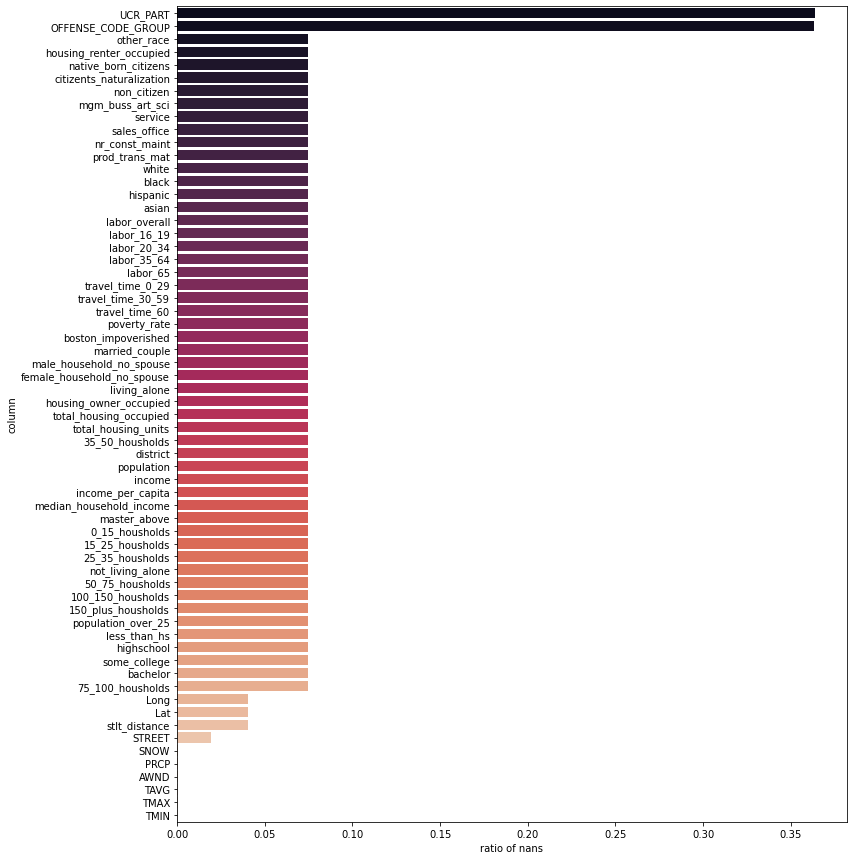

In [7]:
g = df[df.columns[df.isna().any(0)]].isna().sum().sort_values(ascending=False) / df.shape[0]
g = g.reset_index().rename(columns={'index': 'column', 0: 'nans'})
sns.barplot(x='nans', y='column', data=g, ax=plt.subplots(1,1,figsize=(12,15))[1], palette='rocket')
plt.xlabel('ratio of nans');

### Removing data with missing neighborhood weather information 

In [8]:
index_nan_neigh = df[df['neighborhood']==0].index
df = df.drop(index_nan_neigh, axis=0)

df = df.dropna(subset=["TAVG"])

### Treemap representation of type of crime in Boston

In [9]:
pio.renderers.default = 'iframe'

# Crime category data
crime_count = df['OFFENSE_CODE_GROUP'].value_counts()
crime_categories = pd.DataFrame(data=crime_count.index, columns=["OFFENSE_CODE_GROUP"])
crime_categories['values'] = crime_count.values

# Plot the chart
fig = px.treemap(crime_categories, path = ['OFFENSE_CODE_GROUP'], values=crime_categories['values'], title="Offense types in Boston", color_discrete_sequence = px.colors.sequential.RdBu)
fig.data[0].textinfo = 'label+text+value'
fig.show()

Above tree-map represents the type of crime and the magnitude of it in Boston; and it is clear that most of the crimes are of less severe nature.

### Boston crime data representation on geographic map

Below chart represents the concentration of crime in different area in Boston.

In [10]:
# Create basic Folium crime map (Boston)
boston_crime_map = folium.Map(location=[42.3601,-71.0589], tiles = "Stamen Toner", zoom_start = 11, height = 600)

# Add data for heatmap 
crime_location = df.dropna(axis=0, subset=['Lat','Long'])
crime_location = [[row['Lat'],row['Long']] for index, row in crime_location.iterrows()]
heatmap = HeatMap(crime_location, name=None, min_opacity=0.5, max_zoom=18, radius=10, blur=15, gradient={'0.25':'blue', '0.75':'yellow', '1': 'red'})
heatmap.add_to(boston_crime_map)

# Plot the map
boston_crime_map

### Neighborhood and Crime

Our initial exploration showed that crime rates vary based on the neighborhood. For example, Mattapan which has the highest crime rate and while an affluent neighborhood like Beacon Hill has comparatively low crime rate.  As shown in this graph, we can see that neighborhood has an impact on crime rate. Similar trend can be seen for shooting as well. For example, Roxbury and Back Bay has similar crime rates but the more affluent Back Bay has much smaller shooting rate.

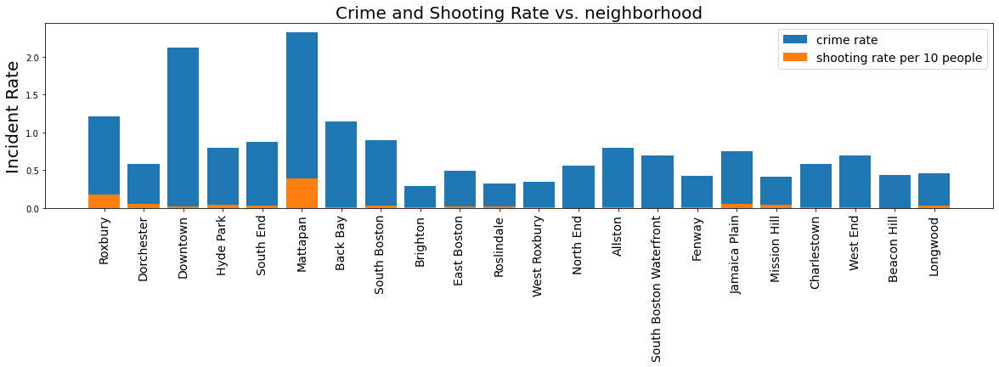

In [11]:
# get crime rate and shooting rage for each neighborhood
df_neighborhood = df.copy()
df_neighborhood.set_index('neighborhood', inplace=True)

num_crimes_by_neighborhood = df.groupby('neighborhood').size().sort_values(ascending = False)
num_shooting_by_neighborhood = df.groupby('neighborhood').agg('sum')['SHOOTING']

def get_rate(df, key):
    "This function is used to calculate rate of crime based on the population of neighborhood."
    rate = df[key]/df_neighborhood.population[key].iloc[0]
    return rate

def get_race(df,key):
    """ This function is used to get the proportion of race based on population."""
    white = df.loc[key].white.iloc[0]/df.loc[key].population.iloc[0]
    black = df.loc[key].black.iloc[0]/df.loc[key].population.iloc[0]
    hispanic = df.loc[key].hispanic.iloc[0]/df.loc[key].population.iloc[0]
    asian = df.loc[key].asian.iloc[0]/df.loc[key].population.iloc[0]
    other = df.loc[key].other_race.iloc[0]/df.loc[key].population.iloc[0]
    return np.array([white, black, hispanic, asian, other])
    
neighborhood_crime_rate = {key:get_rate(num_crimes_by_neighborhood,key)*get_race(df_neighborhood,key) for key in df_neighborhood.index.unique()}
neighborhood_shooting_rate = {key:10*get_rate(num_shooting_by_neighborhood,key)*get_race(df_neighborhood,key) for key in df_neighborhood.index.unique()}

# This actually shows a good idea about the importance of defining which offences are crime. For example, the neighborhoods that are known to be unsafe (Mattapan, Roxbury, Dorchester etc.) 
# have high shootings which necessary does not match the order of total "crime rate" that includes all types of offences. For example "Back Bay" is an expensive neighborhood and we can see the 
# the shooting rate is not that high while the crime rate is high

fig, ax = plt.subplots(figsize=(20,4))
plt.bar(neighborhood_crime_rate.keys(),[get_rate(num_crimes_by_neighborhood, key) for key in df_neighborhood.index.unique()]
, label='crime rate') 

plt.bar(neighborhood_shooting_rate.keys(),[get_rate(num_shooting_by_neighborhood, key)*10 for key in df_neighborhood.index.unique()]
, label='shooting rate per 10 people') 
plt.xticks(rotation=90,fontsize=14);
plt.ylabel('Incident Rate', fontsize=20);
plt.title('Crime and Shooting Rate vs. neighborhood', fontsize=20);
plt.legend(fontsize=14);

### Minority population(% non-white) and Crime

It appears that the neighborhood with more minority race in percentage have higher crime rate in most cases. There could be other socio-economic factors which we will explore next. 


In [12]:
def make_rate_plot(factor, rate, subj, factor_label):
    '''
    factor: socio-economic subject that is being looked at with the rates
    subj: Either 'crime' or 'shooting'
    factor_label: the lable for the legend
    title: title for the factor
    '''
    if subj == 'crime':
        num = num_crimes_by_neighborhood
        modifier=''
    else:
        num = num_shooting_by_neighborhood*10
        modifier = 'per 10 people'
    
    fig, ax = plt.subplots(figsize=(20,4))
    g = sns.barplot(ax=ax, x=list(rate.keys()), y =[get_rate(num, key) for key in df_neighborhood.index.unique()], label = f'{subj} rate {modifier}', color='lightblue')
    plt.plot(list(rate.keys()),factor/100, label=f"% {factor_label}")
    ax.set_xticklabels(ax.get_xticklabels(),rotation = 90, fontsize=14);
    g.set_ylabel(f'{subj} rate', fontsize=20);
    g.set_title(f'{subj} rate vs. neighborhood and % {factor_label}', fontsize=20);
    g.legend(fontsize=14);

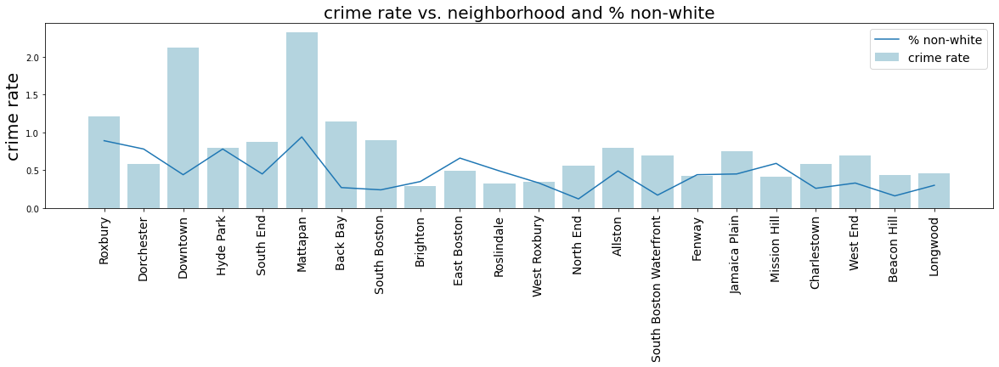

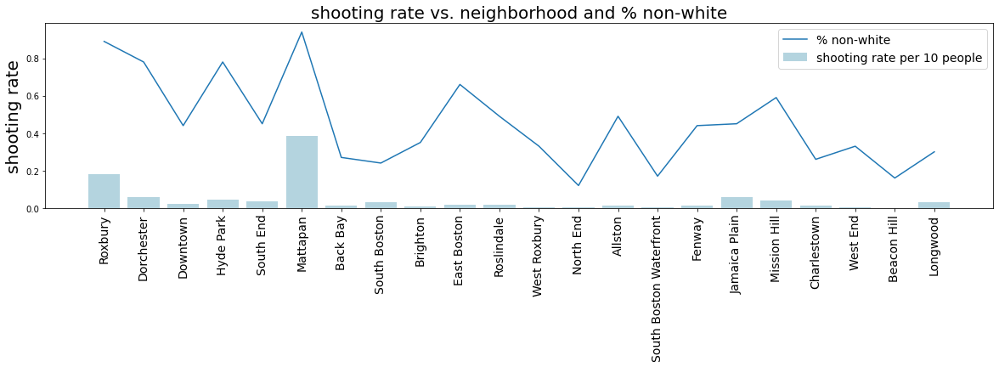

In [13]:
minority = np.array([round((1-item[0])*100) for item in [get_race(df_neighborhood,key) for key in df_neighborhood.index.unique()]])

make_rate_plot(minority, neighborhood_crime_rate, 'crime', 'non-white')

make_rate_plot(minority, neighborhood_shooting_rate, 'shooting', 'non-white')


### Income and Crime
Here we look at the impact of income level on the crime rate. The below graph shows the percentage of households with high incomes (i.e., above 100k) for each neighborhood. We can see that the neighborhoods with less high earners have higher crime rate compared to more richer neighborhoods. As an example, Mattapan has fewer high earners and has higher crime rate compared to Beacon Hill which has lower crime rate and more high earners. 

In [14]:
# get crime rate and shooting rage for each neighborhood

def get_income(df,key):
    under_15_housholds = df.loc[key]['0_15_housholds'].iloc[0]/df.loc[key].population.iloc[0]
    to_25_housholds = df.loc[key]['15_25_housholds'].iloc[0]/df.loc[key].population.iloc[0]
    to_35_housholds = df.loc[key]['25_35_housholds'].iloc[0]/df.loc[key].population.iloc[0]
    to_50_housholds = df.loc[key]['35_50_housholds'].iloc[0]/df.loc[key].population.iloc[0]
    to_75_housholds = df.loc[key]['50_75_housholds'].iloc[0]/df.loc[key].population.iloc[0]
    to_100_housholds = df.loc[key]['75_100_housholds'].iloc[0]/df.loc[key].population.iloc[0]
    to_150_housholds = df.loc[key]['100_150_housholds'].iloc[0]/df.loc[key].population.iloc[0]
    above_150_housholds = df.loc[key]['150_plus_housholds'].iloc[0]/df.loc[key].population.iloc[0]
    return np.array([under_15_housholds, to_25_housholds, to_35_housholds, to_50_housholds, to_75_housholds, to_100_housholds, to_150_housholds, above_150_housholds])

   
neighborhood_crime_rate_income = {key:get_rate(num_crimes_by_neighborhood,key)*get_income(df_neighborhood,key) for key in df_neighborhood.index.unique()}

neighborhood_shooting_rate_income = {key:10*get_rate(num_shooting_by_neighborhood,key)*get_income(df_neighborhood,key) for key in df_neighborhood.index.unique()}

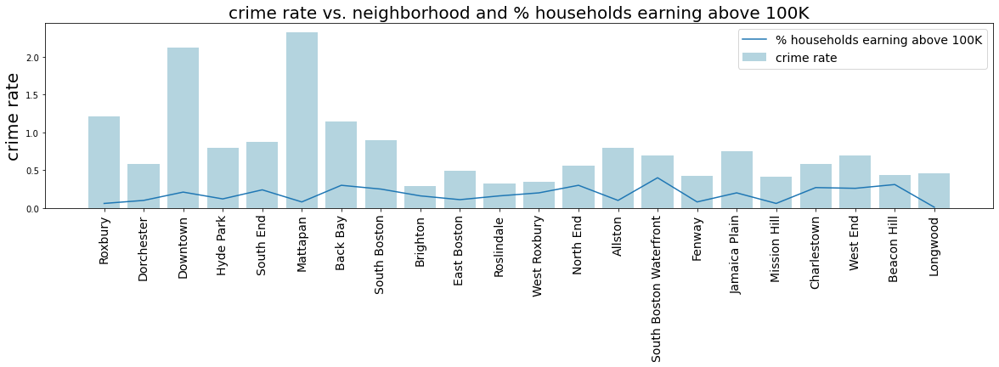

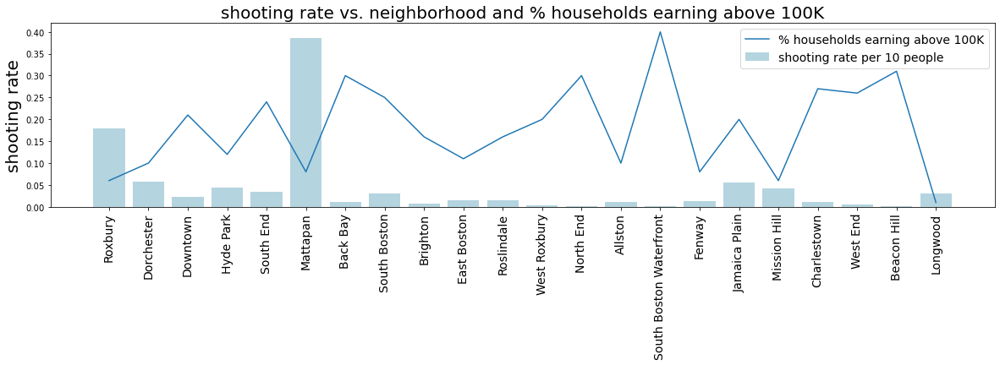

In [15]:
high_income = np.array([round((item[6]+item[7])*100) for item in [get_income(df_neighborhood,key) for key in df_neighborhood.index.unique()]])

make_rate_plot(high_income, neighborhood_crime_rate_income, 'crime', 'households earning above 100K')

make_rate_plot(high_income, neighborhood_shooting_rate_income, 'shooting', 'households earning above 100K')


### Education  and Crime
As seen in the plot below neighborhoods which has lower education level have higher crime rate compared to neighborhood with higher education level. As an example, Mattapan has lower percentage of people with higher education, and has higher crime rate compared to Beacon Hill which has lower crime rate and higher education level. 

In [16]:
# get crime rate and shooting rage for each neighborhood
def get_education(df,key):
    less_than_hs = df.loc[key].less_than_hs.iloc[0]/df.loc[key].population.iloc[0]
    highschool = df.loc[key].highschool.iloc[0]/df.loc[key].population.iloc[0]
    some_college = df.loc[key].some_college.iloc[0]/df.loc[key].population.iloc[0]
    bachelor = df.loc[key].bachelor.iloc[0]/df.loc[key].population.iloc[0]
    master_above = df.loc[key].master_above.iloc[0]/df.loc[key].population.iloc[0]
    return np.array([less_than_hs, highschool, some_college, bachelor, master_above])
    
neighborhood_crime_rate_education = {key:get_rate(num_crimes_by_neighborhood,key)*get_education(df_neighborhood,key) for key in df_neighborhood.index.unique()}

neighborhood_shooting_rate_education = {key:10*get_rate(num_shooting_by_neighborhood,key)*get_education(df_neighborhood,key) for key in df_neighborhood.index.unique()}

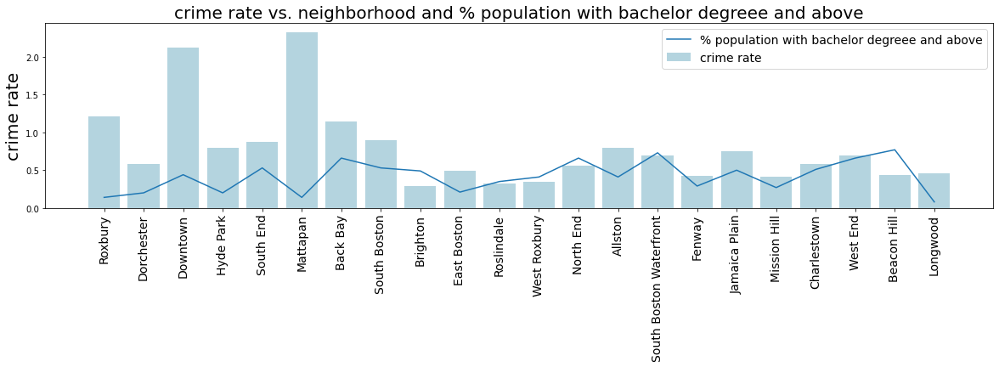

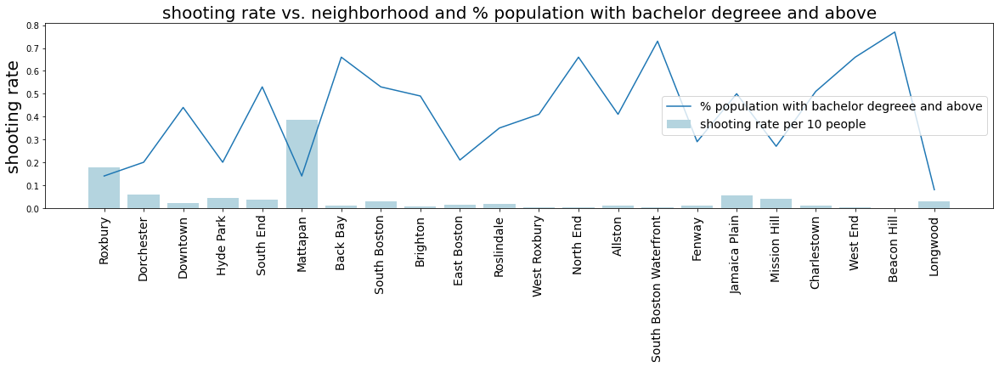

In [17]:
less_educated = np.array([round((item[3]+item[4])*100) for item in [get_education(df_neighborhood,key) for key in df_neighborhood.index.unique()]])

make_rate_plot(less_educated, neighborhood_crime_rate_education, 'crime', 'population with bachelor degreee and above')

make_rate_plot(less_educated, neighborhood_shooting_rate_education, 'shooting', 'population with bachelor degreee and above')



### Weather and Crime
Here we look at the impact of weather temperature on the crime rate defined here as number of incidents divided by number of days (with different temperature categories). For instance, the graph shows that on a given cold day where the average temperature was below freezing, on average around 40 type 1, 80 type 2, and 100 type 3 crimes happened. Based on the plot we can see that crime rate is higher for hot days compared to milder or cold days. 

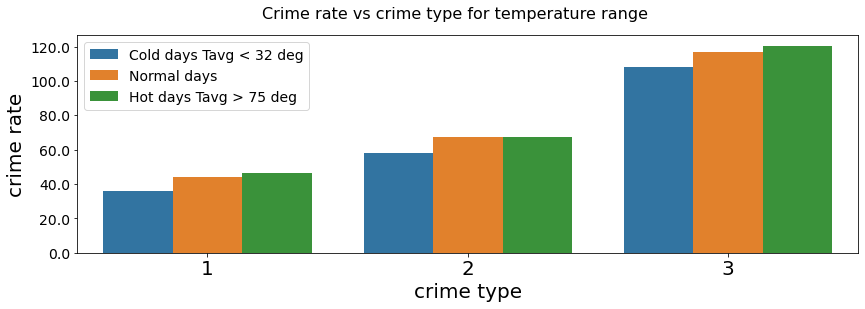

In [18]:
#We plot the weather and crime rate with crime types. 

df_new = df.copy()
cond = df_new['TAVG'] < 32 
cond2 = df_new['TAVG'] > 75 
df_new['cold_ind'] = 0
df_new.loc[cond, 'cold_ind'] = 1

df_new['hot_ind'] = 0
df_new.loc[cond2, 'hot_ind'] = 1

freezing_days = df_new[df_new['TAVG']<32].groupby('DATE').size().shape[0]

hot_days = df_new[df_new['TAVG']>75].groupby('DATE').size().shape[0]

normal_days = df_new.groupby('DATE').size().shape[0] - hot_days - freezing_days


normal_list = (df_new[(df_new['cold_ind']==0) & (df_new['hot_ind']==0)].groupby(['crime_type'], sort=True).size()/normal_days).tolist()
cold_list = (df_new[df_new['cold_ind']==1].groupby(['crime_type'], sort=True).size()/freezing_days).tolist()
hot_list = (df_new[df_new['hot_ind']==1].groupby(['crime_type'], sort=True).size()/hot_days).tolist()

type_list = [1, 2, 3]
prec_data = {'rates': cold_list+normal_list+hot_list,
        'type': type_list * 3,
        'weath': ['Cold days Tavg < 32 deg']*3 + ['Normal days']*3 + ['Hot days Tavg > 75 deg']*3,    
        }

df_prec = pd.DataFrame(prec_data)

fig, axes = plt.subplots(figsize=(14, 4))
fig.suptitle("Crime rate vs crime type for temperature range", fontsize=16)

g = sns.barplot(data=df_prec,  x='type', y ='rates',hue='weath')
g.set_ylabel('crime rate', fontsize=20);
g.set_xlabel('crime type', fontsize=20);
g.set_xticklabels(g.get_xticks(), size =20);
g.set_xticklabels(range(1,4));
g.set_yticklabels(g.get_yticks(), size =14);
g.legend(fontsize=14);

### Crime Trends
**Based on chart below we can see some interesting trend as:**
- Overall crime incidents were very high in 2016, 2017 and 2018; after that it has considerably decreased.
- Summer months have more crime compared to the winter months.
- Friday have overall higher crime rates than other days.
- Most number of crime occurs in early evening time.

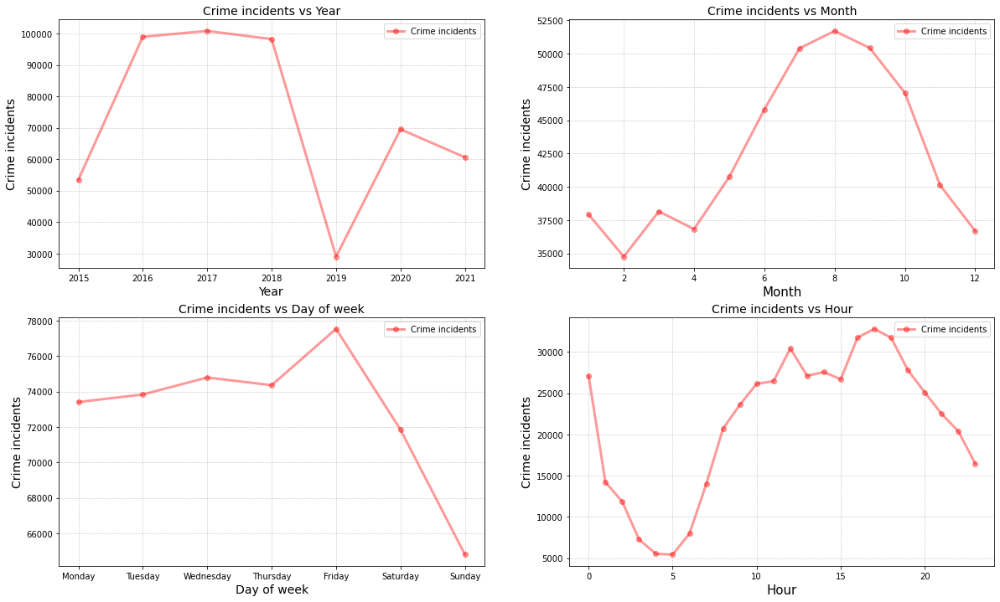

In [19]:
# Crime data based on Year
yearly_df = df.groupby(["YEAR"]).agg({'INCIDENT_NUMBER':['count']}).reset_index()
yearly_df.columns=['year', 'incidents']

# Crime data based on Month
month_df = df.groupby(["MONTH"]).agg({'INCIDENT_NUMBER':['count']}).reset_index()
month_df.columns=['month', 'incidents']

# Crime data based on Day of Week
day_df = df.groupby(["DAY_OF_WEEK"]).agg({'INCIDENT_NUMBER':['count']}).reset_index()
day_df.columns=['dow', 'incidents']
days = {'Monday':0,'Tuesday':1, 'Wednesday':2, 'Thursday':3, 'Friday':4, 'Saturday':5, 'Sunday':6}
day_df['day_of_week_no'] = day_df['dow'].apply(lambda x: days[x])
day_df = day_df.sort_values(by=['day_of_week_no'])

# Crime data based on Hour
hourly_df = df.groupby(["HOUR"]).agg({'INCIDENT_NUMBER':['count']}).reset_index()
hourly_df.columns=['hour', 'incidents']

# Plotting the charts
fig, ax = plt.subplots(2, 2, figsize=(20,12))

# Yearly chart
ax[0,0].plot(yearly_df['year'], yearly_df['incidents'], 'o-', label = 'Crime incidents', linewidth=3, color='r', alpha=0.4)
ax[0,0].set_xlabel("Year", fontsize = 14)
ax[0,0].set_ylabel("Crime incidents", fontsize = 14)
ax[0,0].grid(ls=':')
ax[0,0].legend(loc='upper right')
ax[0,0].set_title("Crime incidents vs Year", fontsize = 14)

# Monthly chart
ax[0,1].plot(month_df['month'], month_df['incidents'], 'o-', label = 'Crime incidents', linewidth=3, color='r', alpha=0.4)
ax[0,1].set_xlabel("Month", fontsize = 15)
ax[0,1].set_ylabel("Crime incidents", fontsize = 14)
ax[0,1].grid(ls=':')
ax[0,1].legend(loc='upper right')
ax[0,1].set_title("Crime incidents vs Month", fontsize = 14)

# Day of week chart
ax[1,0].plot(day_df['dow'], day_df['incidents'], 'o-', label = 'Crime incidents', linewidth=3, color='r', alpha=0.4)
ax[1,0].set_xlabel("Day of week", fontsize = 14)
ax[1,0].set_ylabel("Crime incidents", fontsize = 14)
ax[1,0].grid(ls=':')
ax[1,0].legend(loc='upper right')
ax[1,0].set_title("Crime incidents vs Day of week", fontsize = 14)

# Day of hour chart
ax[1,1].plot(hourly_df['hour'], hourly_df['incidents'], 'o-', label = 'Crime incidents', linewidth=3, color='r', alpha=0.4)
ax[1,1].set_xlabel("Hour", fontsize = 15)
ax[1,1].set_ylabel("Crime incidents", fontsize = 14)
ax[1,1].grid(ls=':')
ax[1,1].legend(loc='upper right')
ax[1,1].set_title("Crime incidents vs Hour", fontsize = 14)

plt.show()


### Socioeconomic Dimensional Splits

Seeing as we have created a custom response variable categorizing the different crime types, we wanted to see whether we can identify any trends in socioeconomic variables that may correspond to our different crime types. For starters, we took a look at median income as a possible identifier for crime types

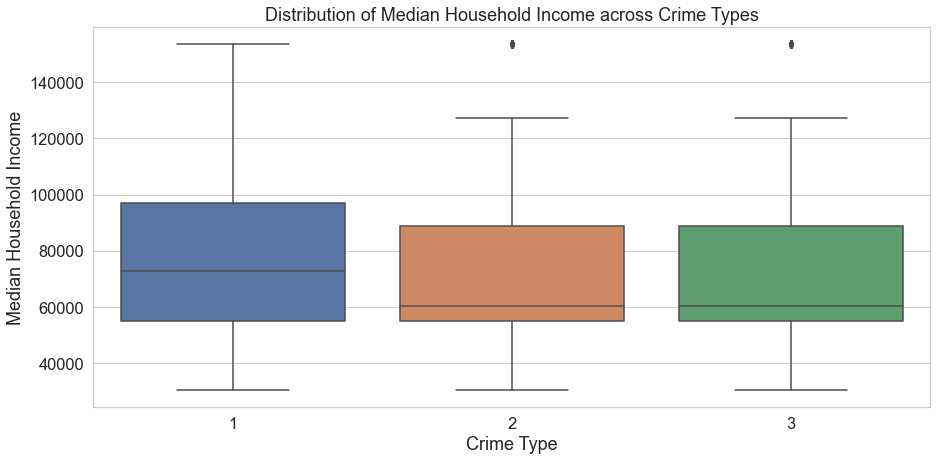

In [20]:
sns.set(rc={'figure.figsize':(15, 7)}, font_scale=1.5)
sns.set_style("whitegrid")
median_income_df = df[["median_household_income", "crime_type"]]

median_plot = sns.boxplot(
    data=median_income_df,
    x="crime_type",
    y="median_household_income"
)

median_plot.set(
    xlabel="Crime Type",
    ylabel="Median Household Income",
    title="Distribution of Median Household Income across Crime Types"
)

plt.show()

Based off of these distributions, it seems that there seems to be a wider spread of median incomes for Type 1, or the most violent crimes. The median of the income distribution of Type 1 crimes is higher than that of Type 2 and 3 crimes. This differentiating factor could be of use to us in identifying Type 1 crimes.



# Model building, selection and validation

Based on above exploratory data analysis (EDA), we think the socio-economic and demographic factors of neighborhood can be a very important factors in determining the crime. Our goal for this project is to analyze the relationship between socio-economic status of a neighborhood and crime incidents. As part of this project we will try to analyze the impact of other factors as weather, street light distance from the crime incidents, hour and day of crime. 
<br>
<br>
Using this analysis we will try to identify the probable reasons behind a crime in Boston neighborhood as well as try to build a model that will predict the severity of crime  (Part I, Part II and Part III) as defined in uniform crime reporting (UCR) given the available predictors (socio-economic, weather etc.)

### Feature engineering 

Feature engineering is very important for any machine learning modeling excercise. As part of this project we have gathered data from different sources; so there are lot of opportunity in feature engineering space to have a better model.
<br>
<br>
Below are the techniques used as part of feature engineering for this modeling excercise:
- Street light distance is converted to a binary variable, 1 is assigned if distance is within 20 meters otherwise 0 is assigned. The basic thought behind this is that if street light is far visibility can be less and chance of occuring a crime can be more.
- 24 hours are divided in four bands for 6 hours each to have less number of hour predictors, and without much information loss because weather/lighting condition might not vary much within these hour bands.
- All the population related predictors are divided by the neighborhood population to have similar scaling for all the neighborhood.
- Education related predicors are scaled accordingly to have same scale across all the neighborhood.
- Similar technique is used to scale the housing occupied variables too.
- Holiday feature is created based on US holidays.
- is_weekend feature is derived based on the day; just to identify if this predictor can provide useful information to the model.
- One hot encoding is done for the categorical variables Month and hour_band


In [21]:
# Feature Engineering
model_df = df.copy()

# 6 Hour bands (24 hours is divided in 4 equal segments)
model_df['hour_band'] = model_df['HOUR']//6

# Distance from street light (Less than 20 meters or not)
model_df['street_light'] = np.where(model_df['stlt_distance'] < 20, 1, 0)

# Convert number to proportion
model_df['native_born_citizens'] =  model_df['native_born_citizens']/model_df['population']
model_df['citizents_naturalization'] =  model_df['citizents_naturalization']/model_df['population']
model_df['non_citizen'] =  model_df['non_citizen']/model_df['population']
model_df['white'] =  model_df['white']/model_df['population']
model_df['black'] =  model_df['black']/model_df['population']
model_df['hispanic'] =  model_df['hispanic']/model_df['population']
model_df['asian'] =  model_df['asian']/model_df['population']
model_df['other_race'] =  model_df['other_race']/model_df['population']

# Convert number to proportion
model_df['less_than_hs'] = model_df['less_than_hs']/model_df['population_over_25']
model_df['highschool'] = model_df['highschool']/model_df['population_over_25']
model_df['some_college'] = model_df['some_college']/model_df['population_over_25']
model_df['bachelor'] = model_df['bachelor']/model_df['population_over_25']
model_df['master_above'] = model_df['master_above']/model_df['population_over_25']

# Convert number to proportion
model_df['housing_owner_occupied'] = model_df['housing_owner_occupied']/model_df['total_housing_occupied']
model_df['housing_renter_occupied'] = model_df['housing_renter_occupied']/model_df['total_housing_occupied']
model_df['total_housing_occupied'] = model_df['total_housing_occupied']/model_df['total_housing_units']

# Convert count of households based on income to proportion
model_df['total_households'] = model_df['0_15_housholds'] + model_df['15_25_housholds'] + model_df['25_35_housholds'] \
                                + model_df['35_50_housholds'] + model_df['50_75_housholds'] + model_df['75_100_housholds'] \
                                + model_df['100_150_housholds'] + model_df['150_plus_housholds']
                                                                                                                                 
model_df['0_15_housholds'] = model_df['0_15_housholds']/model_df['total_households'] 
model_df['15_25_housholds'] = model_df['15_25_housholds']/model_df['total_households'] 
model_df['25_35_housholds'] = model_df['25_35_housholds']/model_df['total_households'] 
model_df['35_50_housholds'] = model_df['35_50_housholds']/model_df['total_households'] 
model_df['50_75_housholds'] = model_df['50_75_housholds']/model_df['total_households'] 
model_df['75_100_housholds'] = model_df['75_100_housholds']/model_df['total_households'] 
model_df['100_150_housholds'] = model_df['100_150_housholds']/model_df['total_households'] 
model_df['150_plus_housholds'] = model_df['150_plus_housholds']/model_df['total_households']

model_df['75K_plus_housholds'] = (model_df['75_100_housholds'] + model_df['100_150_housholds'] \
                                  + model_df['150_plus_housholds']) / model_df['total_households']

# Convert count of type of work to proportion
model_df['total_workers'] = model_df['mgm_buss_art_sci'] + model_df['service'] + model_df['sales_office'] \
                            + model_df['nr_const_maint'] + model_df['prod_trans_mat']

model_df['mgm_buss_art_sci'] = model_df['mgm_buss_art_sci']/model_df['total_workers']
model_df['service'] = model_df['service']/model_df['total_workers']
model_df['sales_office'] = model_df['sales_office']/model_df['total_workers']
model_df['nr_const_maint'] = model_df['nr_const_maint']/model_df['total_workers']
model_df['prod_trans_mat'] = model_df['prod_trans_mat']/model_df['total_workers']

# Holidays and weekend
us_holidays = holidays.UnitedStates()
model_df['holiday'] = (model_df['DATE'].isin(us_holidays))*1
model_df['is_weekend'] = (pd.to_datetime(model_df['DATE']).dt.dayofweek)//5

# Keeping the more severe offense record in case more charges are applied with the same INCIDENT_NUMBER
# This reduces data count, but might help in reducing ambiguity in the model for prediction
model_df['incident_rank'] = model_df.groupby('INCIDENT_NUMBER')['crime_type'].rank(method='first')
model_df = model_df[model_df['incident_rank'] == 1]
model_df = model_df.drop(['incident_rank'], axis = 1)

# One hot encoding for MONTH and hour_band
model_df = pd.get_dummies(model_df, columns = ['MONTH', 'hour_band'], drop_first=True)

model_df.dropna(subset=['Lat'], inplace=True)

In [22]:
# Response variables
response =  'crime_type'

# Defined predictors (for base model, will be enhanced later)
predictors = ['Lat', 'Long','AWND', 'PRCP', 'SNOW', 'TAVG', 'TMAX', 'TMIN', 'is_weekend', 
              'MONTH_2', 'MONTH_3', 'MONTH_4', 'MONTH_5', 'MONTH_6', 'MONTH_7', 
              'MONTH_8', 'MONTH_9', 'MONTH_10', 'MONTH_11', 'MONTH_12', 'hour_band_1', 
              'hour_band_2', 'hour_band_3','street_light', 'population', 'income_per_capita', 
              'median_household_income', '0_15_housholds', '15_25_housholds', '25_35_housholds', 
              '35_50_housholds', '50_75_housholds', '75_100_housholds', '100_150_housholds', 
              '150_plus_housholds', 'less_than_hs', 'highschool', 'some_college', 'bachelor', 
              'master_above', 'total_housing_occupied', 'housing_owner_occupied', 
              'housing_renter_occupied', 'native_born_citizens', 'citizents_naturalization',
              'non_citizen', 'mgm_buss_art_sci', 'service', 'sales_office', 'nr_const_maint', 
              'prod_trans_mat','white', 'black', 'hispanic', 'asian', 'other_race',
              'labor_overall', 'labor_16_19', 'labor_20_34', 'labor_35_64', 'labor_65', 'travel_time_0_29',
              'travel_time_30_59', 'travel_time_60', 'poverty_rate', 'boston_impoverished', 'married_couple',
              'male_household_no_spouse', 'female_household_no_spouse', 'living_alone', 'not_living_alone']

# Fix a random_state
random_state = 22

# Get predictor and response variables
X = model_df[predictors]
y = model_df[response]

# Train test split (80 - 20 split)
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=random_state, stratify=model_df["crime_type"])

# Scaled data
scaler = StandardScaler().fit(X_train)
X_train_scaled = pd.DataFrame(scaler.transform(X_train), index = X_train.index, columns = predictors)
X_test_scaled = pd.DataFrame(scaler.transform(X_test), index = X_test.index, columns = predictors)

### Naive Model

This predicts every observation as type_3 which is the largest observed crime type. As shown below, around 52% of the entire dataset belongs to type 3 crime

In [23]:
# Naive model accuracy (preedicting everything as type_3)

naive_accuracy = model_df[model_df['crime_type']==3].shape[0] / model_df.shape[0]
print(f"Naive model accuracy is :{naive_accuracy:.4f}")

Naive model accuracy is :0.5172


## Logistic regression (Base model)

The base model as shown below shows only a slight improvent to the Naive model.


==========================================CONFUSION MATRIX============================================

[[ 1387     0 17196]
 [  573     0 24243]
 [ 1032     0 45460]]

=========================================CLASSIFICATION REPORT=========================================

              precision    recall  f1-score   support

           1      0.464     0.075     0.129     18583
           2      0.000     0.000     0.000     24816
           3      0.523     0.978     0.682     46492

    accuracy                          0.521     89891
   macro avg      0.329     0.351     0.270     89891
weighted avg      0.366     0.521     0.379     89891


==========================================ACCURACY AND AUC============================================

Accuracy (Train) from Logistic model is: 0.5207
Accuracy from Logistic model is: 0.5212
AUC score from Logistic model is: 0.5716




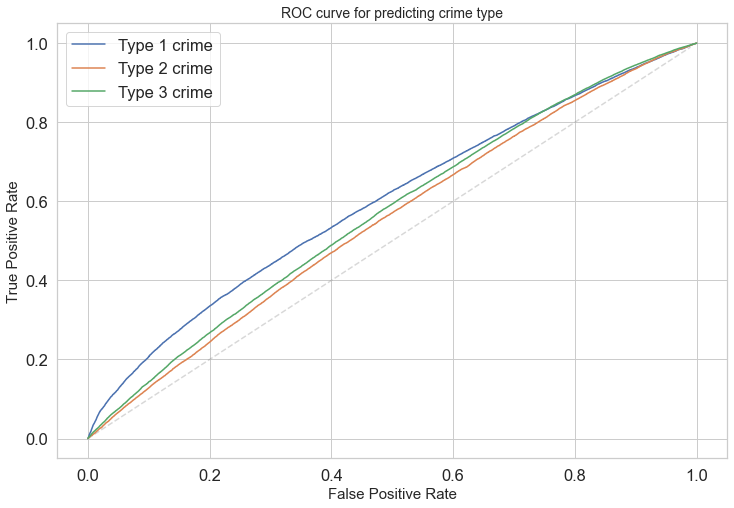

run time: 27.6 seconods


In [45]:
start_time = time.time()

# Train the logistic regression and predict
y_pred_train, y_pred_test, y_proba_train, y_proba_test, model = util.build_logistic_reg(X_train_scaled, y_train, X_test_scaled, y_test)

# Make ROC plot
util.make_roc_plot(y_test, y_proba_test)

print(f"run time: {(time.time() - start_time):.1f} seconods")

#### Display the beta values




Logistic Regression Estimated Betas:

	intercept                           (β0)   	-0.4239		-0.1025		0.5265
	Lat                                 (β1)   	-0.0010		-0.0079		0.0088
	Long                                (β2)   	0.0044		0.0024		-0.0067
	AWND                                (β3)   	-0.0034		-0.0097		0.0131
	PRCP                                (β4)   	0.0001		-0.0140		0.0139
	SNOW                                (β5)   	-0.0140		-0.0016		0.0156
	TAVG                                (β6)   	-0.0198		0.0178		0.0020
	TMAX                                (β7)   	0.0055		0.0009		-0.0064
	TMIN                                (β8)   	0.0222		-0.0189		-0.0033
	is_weekend                          (β9)   	0.0218		-0.0391		0.0173
	MONTH_2                             (β10)   	-0.0116		0.0048		0.0068
	MONTH_3                             (β11)   	-0.0242		0.0100		0.0142
	MONTH_4                             (β12)   	-0.0051		0.0008		0.0043
	MONTH_5                             (β13)   	-0.0145	

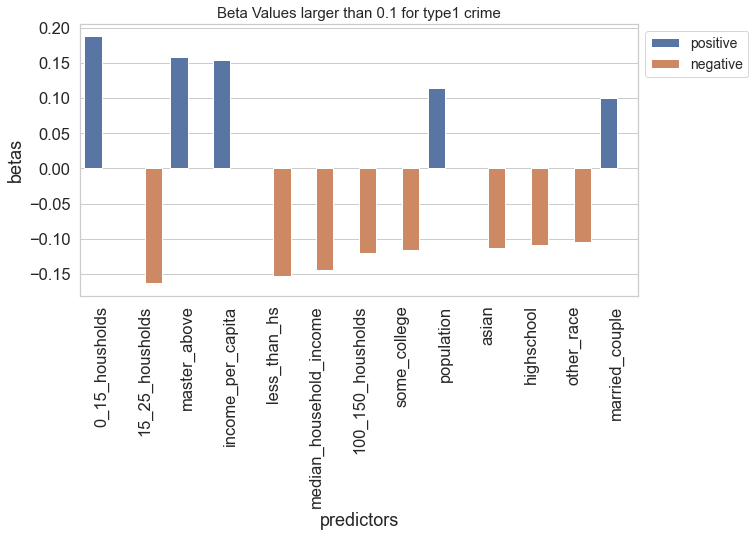

In [46]:
# Display the beta values
util.display_betas(X_test_scaled, model)

### Impact of socio-economic factors on predictions

Here we look at the impact of race and income on the ability of the model to predict the more severe type 1 crimes.

In [47]:
proba_df = pd.DataFrame(y_proba_test, index = y_test.index, columns=['type1_proba', 'type2_proba', 'type3_proba'])
proba_df['crime_type'] = model_df.crime_type[y_test.index]
proba_df['prediction'] = y_pred_test

proba_df['error']=0
proba_df.loc[proba_df['crime_type']==1, 'error'] = 1-proba_df['type1_proba']
proba_df.loc[proba_df['crime_type']==2, 'error'] = 1-proba_df['type2_proba']
proba_df.loc[proba_df['crime_type']==3, 'error'] = 1-proba_df['type3_proba']


model_df_test = model_df.loc[X_test.index]

white_index_test = model_df_test[model_df_test['white']>0.6].index
other_race_index_test = model_df_test[model_df_test['white']<0.6].index

proba_df_white = proba_df.loc[white_index_test]
proba_df_other_race = proba_df.loc[~proba_df.index.isin(white_index_test)]

high_income_index_test = model_df_test[model_df_test['median_household_income']>80000].index
low_income_index_test = model_df_test[model_df_test['median_household_income']<80000].index

proba_df_high_income = proba_df.loc[high_income_index_test]
proba_df_low_income = proba_df.loc[~proba_df.index.isin(high_income_index_test)]

### Predicted crime types vs actual crime types

We can see below that the model does not perform equally for different type of neighborhoods as it fails to predict type 1 crime for neighborhoods with more minorities or lower income making the model less accurate for those neighborhoods.

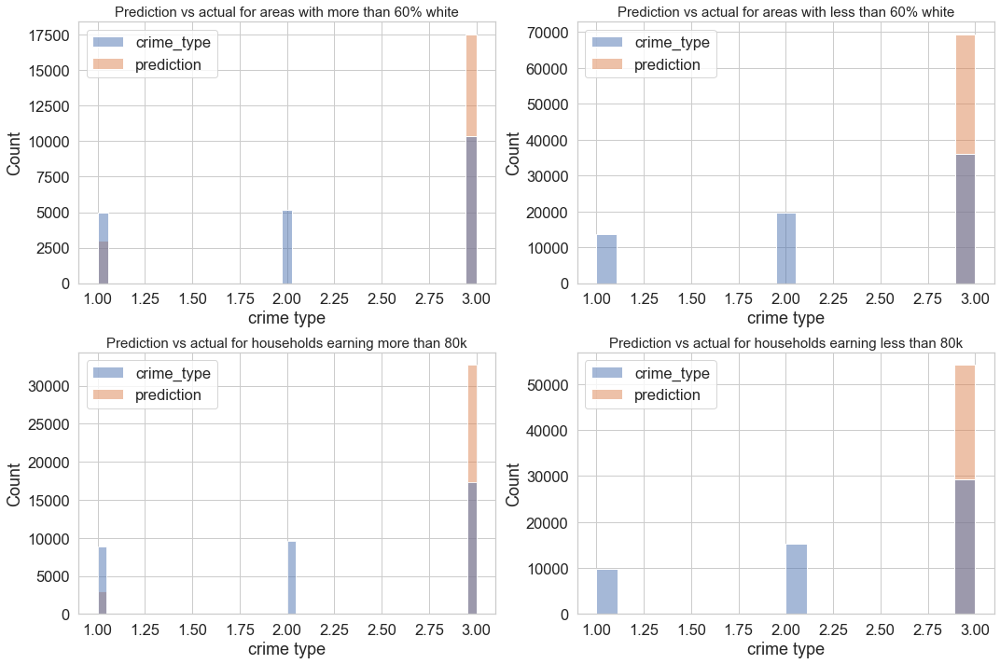

In [89]:
fig, axes = plt.subplots(2,2, figsize=(15, 10))
axes = axes.ravel()

g=sns.histplot(proba_df_white[['crime_type', 'prediction']], ax=axes[0])
g.set_title('Prediction vs actual for areas with more than 60% white', fontsize=15)
g.set_xlabel('crime type');

g=sns.histplot(proba_df_other_race[['crime_type', 'prediction']], ax=axes[1])
g.set_title('Prediction vs actual for areas with less than 60% white', fontsize=15)
g.set_xlabel('crime type');


g=sns.histplot(proba_df_high_income[['crime_type', 'prediction']], ax=axes[2])
g.set_title('Prediction vs actual for households earning more than 80k', fontsize=15)
g.set_xlabel('crime type');


g=sns.histplot(proba_df_low_income[['crime_type', 'prediction']], ax=axes[3])
g.set_title('Prediction vs actual for households earning less than 80k', fontsize=15)
g.set_xlabel('crime type');

fig.tight_layout()

### Predicted Type 1 crime probabilities

Here we show the predicted probabilites and their error rates for type 1 crimes. The error is defined as 1 minus the probability predicted for type1 crimes for all the actual type1 crimes for two groups of races and income levels. These graphs also show how the model accuracy is different for the different types of neighborhoods.

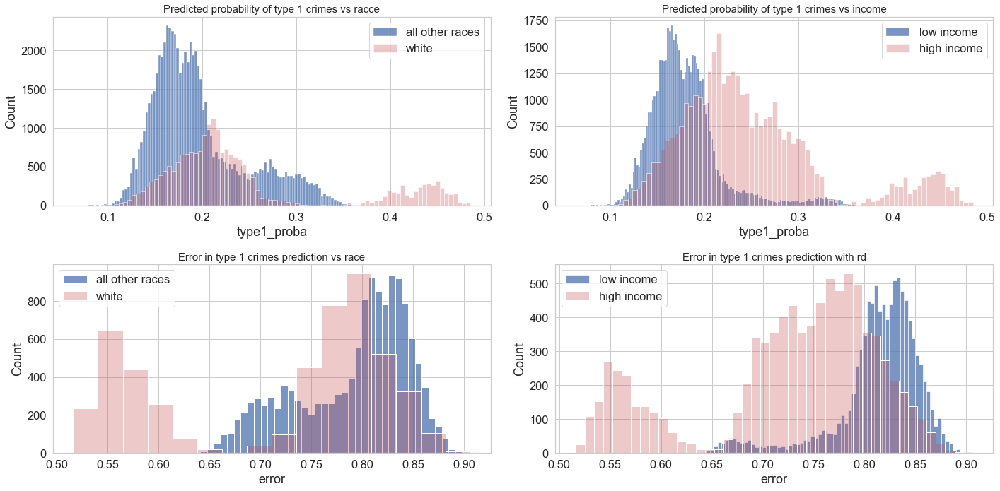

In [49]:
fig, axes = plt.subplots(2,2, figsize=(20, 10))
axes = axes.ravel()

g=sns.histplot(proba_df_other_race['type1_proba'], label='all other races', ax=axes[0])
g=sns.histplot(proba_df_white['type1_proba'], color='r', alpha=0.3, label='white', ax=axes[0])
g.set_title('Predicted probability of type 1 crimes vs racce', fontsize = 15)
g.legend()

g=sns.histplot(proba_df_low_income['type1_proba'], label='low income', ax=axes[1])
g=sns.histplot(proba_df_high_income['type1_proba'], color='r', alpha=0.3, label='high income', ax=axes[1])
g.set_title('Predicted probability of type 1 crimes vs income', fontsize = 15)
g.legend();

g=sns.histplot(proba_df_other_race[proba_df_other_race['crime_type']==1]['error'], label='all other races', ax=axes[2])
g=sns.histplot(proba_df_white[proba_df_white['crime_type']==1]['error'], color='r', alpha=0.3, label='white', ax=axes[2])
g.set_title('Error in type 1 crimes prediction vs race', fontsize = 15)
g.legend()

g=sns.histplot(proba_df_low_income[proba_df_low_income['crime_type']==1]['error'], label='low income', ax=axes[3])
g=sns.histplot(proba_df_high_income[proba_df_high_income['crime_type']==1]['error'], color='r', alpha=0.3, label='high income', ax=axes[3])
g.set_title('Error in type 1 crimes prediction with rd', fontsize = 15)
g.legend();

fig.tight_layout()

### LASSO-like logistic regression

Here, we perform a cross validated Lasso-like logistic regression with different regularization strenghts. As it is shown below, the selected model has most of the coeffients equal to zero from type 1 and type 2 crimes and it predicts every observation as a type 3 crime similar to the Naive model. 


==========================================CONFUSION MATRIX============================================

[[    0     0 18583]
 [    0     0 24816]
 [    0     0 46492]]

=========================================CLASSIFICATION REPORT=========================================

              precision    recall  f1-score   support

           1      0.000     0.000     0.000     18583
           2      0.000     0.000     0.000     24816
           3      0.517     1.000     0.682     46492

    accuracy                          0.517     89891
   macro avg      0.172     0.333     0.227     89891
weighted avg      0.268     0.517     0.353     89891


==========================================ACCURACY AND AUC============================================

Accuracy (Train) from Logistic model is: 0.5172
Accuracy from Logistic model is: 0.5172
AUC score from Logistic model is: 0.5591




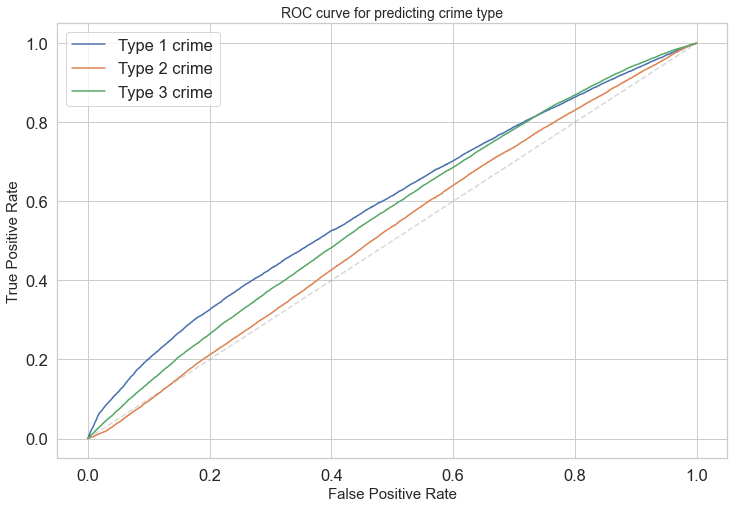

run time: 7525.4 seconods


In [26]:
start_time = time.time()

# Commenting to avoid the rerun
y_pred_train_lasso, y_pred_test_lasso, y_proba_train_lasso, y_proba_test_lasso, lasso_like_logistic = util.build_logistic_reg(X_train_scaled, y_train, X_test_scaled, y_test, penalty='l1', solver='liblinear', cv=True)

util.make_roc_plot(y_test, y_proba_test_lasso)

print(f"run time: {(time.time() - start_time):.1f} seconods")

#### Display the beta values

In [27]:
util.display_betas(X_train, lasso_like_logistic)




Logistic Regression Estimated Betas:

	intercept                           (β0)   	-1.1869		-0.8289		0.0691
	Lat                                 (β1)   	0.0000		0.0000		0.0255
	Long                                (β2)   	0.0000		0.0000		0.0011
	AWND                                (β3)   	0.0000		0.0000		0.0202
	PRCP                                (β4)   	0.0000		0.0000		0.0219
	SNOW                                (β5)   	0.0000		0.0000		0.0221
	TAVG                                (β6)   	0.0000		0.0000		-0.0000
	TMAX                                (β7)   	0.0000		0.0000		-0.0092
	TMIN                                (β8)   	0.0000		0.0000		-0.0015
	is_weekend                          (β9)   	0.0000		0.0000		0.0302
	MONTH_2                             (β10)   	0.0000		0.0000		0.0087
	MONTH_3                             (β11)   	0.0000		0.0000		0.0177
	MONTH_4                             (β12)   	0.0000		0.0000		0.0060
	MONTH_5                             (β13)   	0.0000		0.0000		0.008

### Confidence interval for coefficients

Below, we look at the predicted betas for different regularization strength and the confidence interval around that prediction.

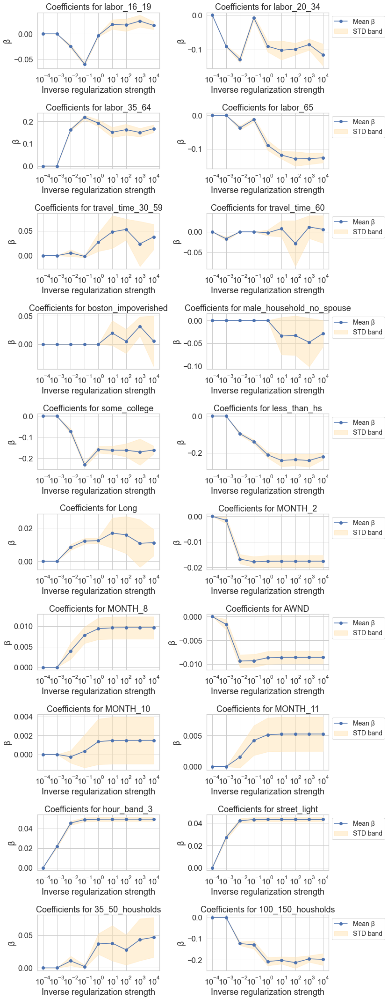

In [37]:
# Regularization parameter
Cs = [1e-4, 1e-3, 1e-2, 1e-1, 1e0, 1e1, 1e2, 1e3, 1e4]

# Sorting and selecting significant betas (above 0.1)
best_betas_df = pd.DataFrame(lasso_like_logistic.coef_[0], columns = ['betas'])
best_betas_df['predictors'] = X_train.columns
best_betas_df = best_betas_df.sort_values(by='betas', key=abs, ascending=False)

# Mean and Std for betas across different cross validation sets
mean_betas = np.mean(lasso_like_logistic.coefs_paths_[1], axis = 0)
std_betas = np.std(lasso_like_logistic.coefs_paths_[1], axis = 0)

best_betas_df = best_betas_df[abs(mean_betas[7][:-1])>0.1]


# Plot the chart
fig_rows = int(np.ceil(best_betas_df.shape[0]/2))
fig, ax = plt.subplots(fig_rows,2, figsize=(12,30))
ax = ax.ravel()

for i, ind in enumerate(best_betas_df.index):
    ax[i].plot(Cs, np.transpose(mean_betas)[ind], 'o-', label='Mean \u03B2')
    ax[i].fill_between(Cs, np.transpose(mean_betas)[ind]-np.transpose(std_betas)[ind], np.transpose(mean_betas)[ind]+np.transpose(std_betas)[ind],
                 color='moccasin', alpha=0.5, label='STD band')
    ax[i].set_xscale('log')
    ax[i].set_xticks(Cs);
    ax[i].set_title(f'Coefficients for {best_betas_df.loc[ind]["predictors"]}')
    ax[i].set_ylabel('\u03B2')
    ax[i].set_xlabel('Inverse regularization strength')
    if (i % 2) != 0:
        ax[i].legend(bbox_to_anchor=(1, 1.0), loc='upper left', fontsize=14)
fig.tight_layout();

### Decision Tree (Hyperparameter tuning)

Below we are trying to find the best depth for a single decision tree as well as the depth which overfits the training data.

In [ ]:
%%time
# set parameters for model fitting
depths = list(range(1, 21))
cv = 5

# perform CV and generate required results
cvmeans, cvstds, train_scores = util.calc_meanstd(X_train, y_train, depths, cv)

# convert results from lists to arrays for plotting function
cvmeans = np.array(cvmeans)
cvstds = np.array(cvstds)


CPU times: user 4min 20s, sys: 9.7 s, total: 4min 30s
Wall time: 4min 32s


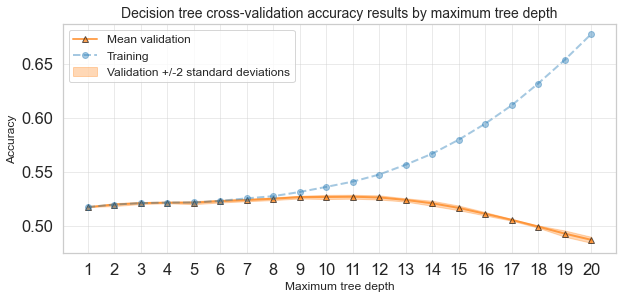

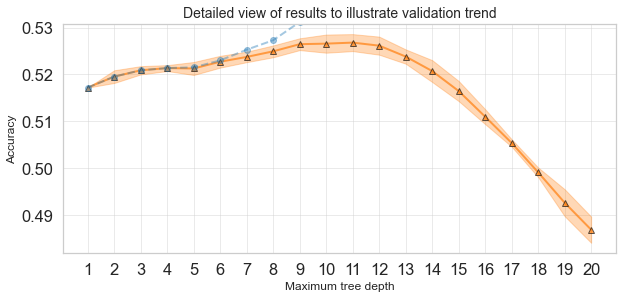

In [50]:
# plot results as full plot
title = ("Decision tree cross-validation accuracy results by maximum tree depth")
util.plot_cv_results(depths, cvmeans, cvstds, train_scores, "Maximum tree depth", title,limit_y=False, show_legend=True,)

# plot results with limited y-axis as required
title = ("Detailed view of results to illustrate validation trend")
util.plot_cv_results(depths, cvmeans, cvstds, train_scores, "Maximum tree depth", title, limit_y=True, show_legend=False,)

In [51]:
%%time
# Decision Tree Classifier

dtree = DecisionTreeClassifier(max_depth=7, random_state=random_state).fit(X_train, y_train)                           
util.model_performance_metrics(dtree, X_train, y_train, X_test, y_test)



==========================================CONFUSION MATRIX============================================

[[ 1465   378 16740]
 [  482   623 23711]
 [  877   538 45077]]

=========================================CLASSIFICATION REPORT=========================================

              precision    recall  f1-score   support

           1      0.519     0.079     0.137     18583
           2      0.405     0.025     0.047     24816
           3      0.527     0.970     0.683     46492

    accuracy                          0.525     89891
   macro avg      0.484     0.358     0.289     89891
weighted avg      0.492     0.525     0.395     89891


==========================================ACCURACY AND AUC============================================

Accuracy (Train) for the model is: 0.5253
Accuracy (Test) for the model is: 0.5247
AUC score for the model is: 0.5777


CPU times: user 2.14 s, sys: 354 ms, total: 2.49 s
Wall time: 2.65 s


### Boosting

#### Hyperparameter tuning
We tune on hyperparameter depth and number of iterations here

In [53]:
%%time

# set hyperparameters and instantiate empty dictionaries
depths =[3,5,7,10]
n_estimators = 200
learning_rate = 0.05

train_scores_depth = {}
test_scores_depth = {}

# fit classifiers and generate staged scores at each depth
for max_depth in depths:
    fitted_ada = AdaBoostClassifier(
        base_estimator=DecisionTreeClassifier(max_depth=max_depth),
        n_estimators=n_estimators,
        learning_rate=learning_rate,
    ).fit(X_train, y_train)
    
    train_scores_depth[max_depth] = list(
        fitted_ada.staged_score(X_train, y_train)
    )
    test_scores_depth[max_depth] = list(
        fitted_ada.staged_score(X_test, y_test)
    )

CPU times: user 26min 45s, sys: 4.7 s, total: 26min 50s
Wall time: 26min 51s


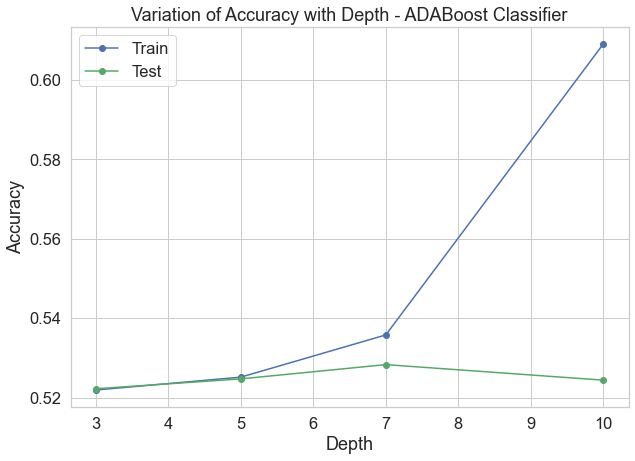

In [92]:
# Calculate average accuracy scores
avg_score_train = []
for _, v in train_scores_depth.items():
    avg_score_train.append(np.mean(v))

avg_score_test= []
for _, v in test_scores_depth.items():
    avg_score_test.append(np.mean(v))

#Plot the chart for Adaboost tuning tree depth parameter
plt.figure(figsize=(10,7))
plt.ylabel("Accuracy")
plt.xlabel("Depth")
plt.title('Variation of Accuracy with Depth - ADABoost Classifier')
plt.plot(depths, avg_score_train, 'o-', color="b", label='Train')
plt.plot(depths, avg_score_test, 'o-', color="g", label='Test')
plt.legend();
plt.show()

In [54]:
%%time
train_scores_e = {}
test_scores_e = {}

n_estimators = [100, 200, 400]
learning_rate = 0.1
for estimator in n_estimators:
    fitted_ada = AdaBoostClassifier(
        base_estimator=DecisionTreeClassifier(max_depth=5),
        n_estimators=estimator,
        learning_rate=learning_rate,
    ).fit(X_train, y_train)
    
    train_scores_e[estimator] = list(
        fitted_ada.staged_score(X_train, y_train)
    )
    test_scores_e[estimator] = list(
        fitted_ada.staged_score(X_test, y_test)
    )

CPU times: user 19min 9s, sys: 2.68 s, total: 19min 12s
Wall time: 19min 13s


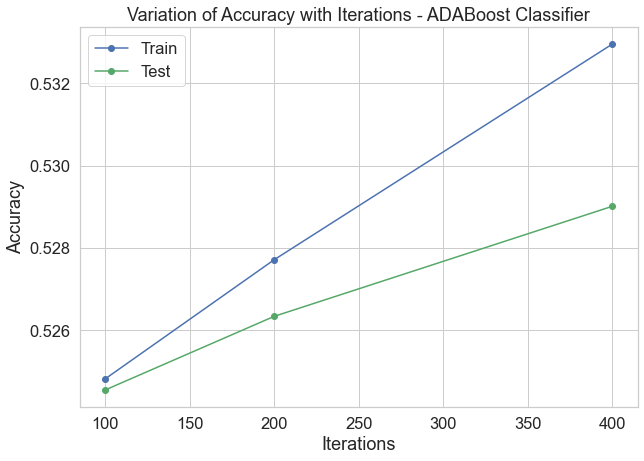

In [90]:
# Calculate average accuracy scores
avg_score_train_e = []
for _, v in train_scores_e.items():
    avg_score_train_e.append(np.mean(v))

avg_score_test_e= []
for _, v in test_scores_e.items():
    avg_score_test_e.append(np.mean(v))

#Plot the chart for Adaboost tuning tree depth parameter
plt.figure(figsize=(10,7))
plt.ylabel("Accuracy")
plt.xlabel("Iterations")
plt.title('Variation of Accuracy with Iterations - ADABoost Classifier')
plt.plot(n_estimators, avg_score_train_e, 'o-', color="b", label='Train')
plt.plot(n_estimators, avg_score_test_e, 'o-', color="g", label='Test')
plt.legend();
plt.show()

### Adaboost classifier

Using the tuned hyperparameters from above, we build an Adaboost classifier here

In [55]:
%%time
# Adaboost Classifier
adaboost = AdaBoostClassifier(base_estimator= DecisionTreeClassifier(max_depth=5), 
                           n_estimators=100, 
                           learning_rate=0.1,
                           random_state = random_state)

# Fit the model on the training set
adaboost.fit(X_train.values, y_train.values)
util.model_performance_metrics(adaboost, X_train, y_train, X_test, y_test)


==========================================CONFUSION MATRIX============================================

[[ 1608    18 16957]
 [  496    47 24273]
 [  837    28 45627]]

=========================================CLASSIFICATION REPORT=========================================

              precision    recall  f1-score   support

           1      0.547     0.087     0.149     18583
           2      0.505     0.002     0.004     24816
           3      0.525     0.981     0.684     46492

    accuracy                          0.526     89891
   macro avg      0.526     0.357     0.279     89891
weighted avg      0.524     0.526     0.386     89891


==========================================ACCURACY AND AUC============================================

Accuracy (Train) for the model is: 0.5273
Accuracy (Test) for the model is: 0.5260
AUC score for the model is: 0.5951


CPU times: user 2min 46s, sys: 588 ms, total: 2min 47s
Wall time: 2min 47s


### Random forest classifier

#### Hyper parameter tuning
We tune the tree depth to find the best accuracy for further modeling of Random Forest

In [56]:
%%time
# Hyper parameter tuning for Random forest
tree_depth_range = range(10, 20, 2)
rf_val_acc = util.get_tree_scores(X_train, 
                             y_train, 
                             RandomForestClassifier(), 
                            tree_depth_range)
rf_mean_acc  = rf_val_acc.groupby("depth").mean()
rf_mean_acc["depth"] = list(tree_depth_range)


max_idx = rf_mean_acc["cv_acc_score"].idxmax()
best_depth_rf = rf_mean_acc["depth"][max_idx]

# Print and report
print("\n=================================================================================================\n")
print("Best tree depth for random forest classifier is: ", best_depth_rf)
print("\n=================================================================================================\n")



Best tree depth for random forest classifier is:  18


CPU times: user 624 ms, sys: 1.14 s, total: 1.76 s
Wall time: 9min 23s


### Random Forest

In [93]:
%%time
# Performing upsampling using SMOTE for Random forest classifier
# Define a SMOTE with random_state=random_state (defined above)
sm = SMOTE(random_state=random_state)

# Use the SMOTE object to upsample the train data
X_train_res, y_train_res = sm.fit_resample(X_train, y_train.ravel())

# Random Forest classifier
random_forest_upsampled = BalancedRandomForestClassifier(max_depth=best_depth_rf, random_state=random_state, n_estimators=200, class_weight='balanced_subsample')

# Fit the Random Forest on upsampled data 
random_forest_upsampled.fit(X_train_res, y_train_res)
util.model_performance_metrics(random_forest_upsampled, X_train, y_train, X_test, y_test)



==========================================CONFUSION MATRIX============================================

[[ 5652  3268  9663]
 [ 4513  6120 14183]
 [ 7474  8504 30514]]

=========================================CLASSIFICATION REPORT=========================================

              precision    recall  f1-score   support

           1      0.320     0.304     0.312     18583
           2      0.342     0.247     0.287     24816
           3      0.561     0.656     0.605     46492

    accuracy                          0.470     89891
   macro avg      0.408     0.402     0.401     89891
weighted avg      0.451     0.470     0.457     89891


==========================================ACCURACY AND AUC============================================

Accuracy (Train) for the model is: 0.6835
Accuracy (Test) for the model is: 0.4704
AUC score for the model is: 0.5862


CPU times: user 12min 7s, sys: 3min 14s, total: 15min 22s
Wall time: 9min 28s


### Feature importance

**Below feature importance charts, that are derived using different tree methods, represent few key items such as:**
- Time of crime is one of the most important predictors.
- Other important predictor is weather information that too is associated with time, and all the tree models are conveying similar information.
- The distance of street light too has played important role of predictor in the model.
- Other interesting predictor is the commute time to work in a given neighborhood.
- One of the socio-economic factor, the househiold type especially "household owned by male with no spouse" has also one of the important predictors identified by these models.
- Other important socio-economic predictor "education" is also highlighted by few of the model as important predictors.
- "Race" too has come up as one of the important predictors from adaboost, but the significant ones are non-white and non-black races.
- The type of industry in a given neighborhood especially "construction and maintainence" is identified as one of the important predictors.

<br>

So, as a whole we can see that predictors those are more granular with respect to crime, such as weather information, street light and time of crime has played more important role, while the other socio-economic factor those arev deived based on neighborhood data has played minor role in predicting the severity of crime.

<br>
And intiutively we can say that this makes sense for this data set as we do not have many socio-economic predictors those can be directly associated with the crime incidents, all we have is for a given neighborhood and that is at very broad level; so these factors has not provided major role in prediction; while the other items those are more granular with crime incidents (time, weather, street light) have more predictive power.

<br>


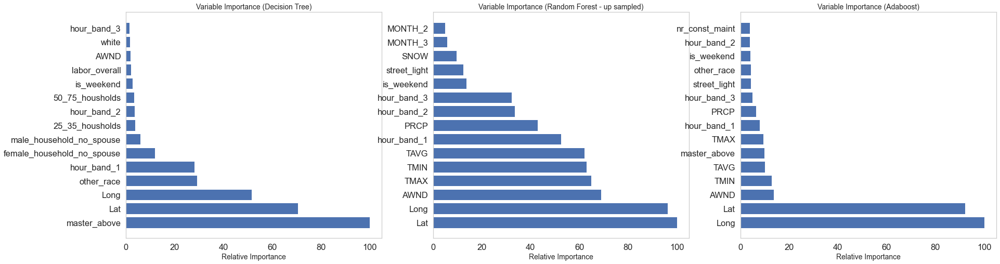

In [103]:
def get_feature_importance(model):
    """
    This function is used to get sorted feature importance information
    for a classification model.
    """
    feature_importance = model.feature_importances_
    relative_feature_importance = (feature_importance/feature_importance.max())*100
    idx =  np.argsort(relative_feature_importance)[::-1][:15]
    feature_importance =  np.sort(relative_feature_importance)[::-1][:15]
    
    return idx, feature_importance

# Plot the feature importance charts
fig, ax = plt.subplots(1, 3, figsize=(30,8))

# Feature importance (Random forest)
idx, feature_importance = get_feature_importance(dtree)
ax[0].barh(X.columns[idx], feature_importance)
ax[0].set_xlabel("Relative Importance", fontsize = 14)
ax[0].set_title("Variable Importance (Decision Tree)", fontsize = 14)
ax[0].grid(False)

# Feature importance (Random forest - upsampled)
idx, feature_importance = get_feature_importance(random_forest_upsampled)
ax[1].barh(X.columns[idx], feature_importance)
ax[1].set_xlabel("Relative Importance", fontsize = 14)
ax[1].set_title("Variable Importance (Random Forest - up sampled)", fontsize = 14)
ax[1].grid(False)

# Feature importance (Adaboost)
idx, feature_importance = get_feature_importance(adaboost)
ax[2].barh(X.columns[idx], feature_importance)
ax[2].set_xlabel("Relative Importance", fontsize = 14)
ax[2].set_title("Variable Importance (Adaboost)", fontsize = 14)
ax[2].grid(False)

plt.show()
fig.tight_layout()

### Ensemble model

After looking at the performance of all the above models, we decided to try an ensembled model to see if accuracy gets improved. We have ensembled three separate models and used the voting mechanism to choose the classes, and final accuracy got improved slightly compared to balanced random forest, but it was still lower than the base model performance.

In [96]:
ensemble_model = VotingClassifier(estimators=[('lr', model), ('rf1', random_forest_upsampled)
                                              , ('ada', adaboost)], voting='hard')

# Fit the model on the training set
ensemble_model.fit(X_train.values, y_train.values)

# Predict on the validation set 
y_pred_train = ensemble_model.predict(X_train.values)
y_pred_test = ensemble_model.predict(X_test.values)

#Performance metrics
acc_ensemble_training = accuracy_score(y_train, y_pred_train)*100
acc_ensemble_test = accuracy_score(y_test, y_pred_test)*100

# Print and report
# Print the confusion matrix
print("\n==========================================CONFUSION MATRIX============================================\n")
print(confusion_matrix(y_test, y_pred_test))

# Print the precision and recall, among other metrics
print("\n=========================================CLASSIFICATION REPORT=========================================\n")
print(classification_report(y_test, y_pred_test, digits=3))

# Print and report
print("\n=================================================================================================\n")
print("Ensemble model:\tAccuracy, Training Set \t: {:0.2f}%".format(acc_ensemble_training))
print("Ensemble model:\tAccuracy, Testing Set \t: {:0.2f}%".format(acc_ensemble_test))
print("\n=================================================================================================\n")


==========================================CONFUSION MATRIX============================================

[[ 1619    10 16954]
 [  503    40 24273]
 [  850    14 45628]]

=========================================CLASSIFICATION REPORT=========================================

              precision    recall  f1-score   support

           1      0.545     0.087     0.150     18583
           2      0.625     0.002     0.003     24816
           3      0.525     0.981     0.684     46492

    accuracy                          0.526     89891
   macro avg      0.565     0.357     0.279     89891
weighted avg      0.557     0.526     0.386     89891



Ensemble model:	Accuracy, Training Set 	: 52.74%
Ensemble model:	Accuracy, Testing Set 	: 52.60%




### Permutation importance

Based on below permutation importance, we can see that tree methods have picked up the time/weather as the top predictors and some of the socio-economic factors; but logistic regression has picked up the median and average income as top predictors. When we look at "Adaboost" it has picked Socio economic indicators such as education and race as well as time and street light predictors.

This is very interesting finding and indicates that we need both type of predictors and need to create ensembled model to rightly predict the type of crime; and it might be important to see if more granular socio-economic information can hel in better predict a crime in Boston.
<br>

**NOTE:** We have used just 5 iteration to identify the important features because it takes time to run; but it has provided a general idea on the importance.

#### Logistic Regression

In [71]:
%%time

#permutation importance for the Logistic regression
perm = PermutationImportance(model, random_state=random_state, n_iter=5).fit(X_test, y_test)
eli5.show_weights(perm, feature_names=X.columns.tolist())

CPU times: user 24.4 s, sys: 5.85 s, total: 30.3 s
Wall time: 4.52 s


Weight,Feature
0.0335 ± 0.0028,median_household_income
0.0298 ± 0.0015,income_per_capita
0.0223 ± 0.0030,population
0 ± 0.0000,75_100_housholds
0 ± 0.0000,50_75_housholds
0 ± 0.0000,35_50_housholds
0 ± 0.0000,25_35_housholds
0 ± 0.0000,15_25_housholds
0 ± 0.0000,0_15_housholds
0 ± 0.0000,TMIN


#### Random Forest

In [95]:
%%time

#permutation importance for the Random forest (upsampled)
perm = PermutationImportance(random_forest_upsampled, random_state=random_state, n_iter=5).fit(X_test, y_test)
eli5.show_weights(perm, feature_names=X.columns.tolist())

CPU times: user 17min 3s, sys: 11.5 s, total: 17min 14s
Wall time: 17min 21s


Weight,Feature
0.0414 ± 0.0022,hour_band_1
0.0292 ± 0.0008,hour_band_3
0.0290 ± 0.0013,hour_band_2
0.0178 ± 0.0014,Lat
0.0085 ± 0.0023,Long
0.0021 ± 0.0009,street_light
0.0012 ± 0.0002,MONTH_2
0.0012 ± 0.0009,is_weekend
0.0012 ± 0.0007,MONTH_3
0.0010 ± 0.0002,MONTH_9


#### Adaboost

In [72]:
%%time

#permutation importance for the Adaboost
perm = PermutationImportance(adaboost, random_state=random_state, n_iter=5).fit(X_test, y_test)
eli5.show_weights(perm, feature_names=X.columns.tolist())

CPU times: user 6min 34s, sys: 993 ms, total: 6min 35s
Wall time: 6min 35s


Weight,Feature
0.0081 ± 0.0006,Lat
0.0065 ± 0.0003,Long
0.0043 ± 0.0003,master_above
0.0021 ± 0.0003,street_light
0.0021 ± 0.0002,other_race
0.0015 ± 0.0006,married_couple
0.0011 ± 0.0001,labor_35_64
0.0010 ± 0.0002,hour_band_1
0.0009 ± 0.0001,travel_time_0_29
0.0008 ± 0.0003,travel_time_60


### LIME

LIME has been used to understand the predictions at observation level. Below are some findings for one of the observations from logistic regression, random forest, and adaboost.

In [84]:
explainer = LimeTabularExplainer(X_train.values,
                                 feature_names=X_train.columns,
                                 class_names = [1,2,3],
                                 mode='classification')

#### Random Forest

In [82]:
idx=210
exp = explainer.explain_instance(X_train.values[idx], random_forest_upsampled.predict_proba, num_features=8, top_labels=2)
print('True class: %s' % y_train.iloc[idx])
# Show the reasons for top 2 classes based on probabilities
exp.show_in_notebook()

True class: 2


#### Logistic Regression

In [85]:

exp = explainer.explain_instance(X_train.values[idx], model.predict_proba, num_features=8, top_labels=2)

# Show the reasons for top 2 classes based on probabilities
exp.show_in_notebook()

#### Adaboost

In [86]:
exp = explainer.explain_instance(X_train.values[idx], adaboost.predict_proba, num_features=8, top_labels=2)

# Show the reasons for top 2 classes based on probabilities
exp.show_in_notebook()

# Modeling crime in Cambridge

In order to compare our findings with another geographic location, we looked at the crime in the city of Cambridge. The primary dataset provided by the City of Cambridge included the description of crimes as well as the time and location the crimes happened including the neighborhood. Additionally, we used the Boston weather data proximity of the two cities and also some socio-economic information for each neighborhood in Cambridge from niche.com. We also created a similar response variable “crime_type” using the description of crime and the keywords we created for UCR crime types.

 The final dataset for Cambridge had many similar types of information compared to Boston but the predictors were not exactly the same. Therefore, we could not use our Boston models to make predictions for Cambridge. We built a new logistic regression model for Cambridge and compared it to the Naïve model of predicting all Cambridge crimes as type 1. The results show that we have a similar accuracy issue with the Cambridge model. This was expected as we had the same issue of observation variance for all socio-economic data as they are similar at the neighborhood level. Additionally, Cambridge is a smaller city and unlike Boston, many of its neighborhoods are very similar in terms of socio-economic factors which makes it even harder to build a model that can accurately make predictions.

In [59]:
# Data preparation for the city of Cambridge

df_cambridge = pd.read_csv("data/other_city/Cambridge_Crime_Reports.csv")
df_cambridge['year'] = df_cambridge['Date of Report'].apply(lambda x: (datetime.strptime(x[0:10], '%m/%d/%Y')).year)
df_cambridge['month'] = df_cambridge['Date of Report'].apply(lambda x: (datetime.strptime(x[0:10], '%m/%d/%Y')).month)
df_cambridge['dow'] = df_cambridge['Date of Report'].apply(lambda x: (datetime.strptime(x[0:10], '%m/%d/%Y')).weekday())
df_cambridge['hour'] = df_cambridge['Date of Report'].apply(lambda x: int(x[11:13]) if x[-2:] == 'AM' else int(x[11:13]) + 12)

# Crime data from 2015
df_cambridge = df_cambridge[df_cambridge['year'] >= 2015]
df_cambridge.shape

df_cambridge_neighborhood = pd.read_csv("data/other_city/cambridge_neighborhood.csv")
df_cambridge = df_cambridge.merge(df_cambridge_neighborhood, on = "Neighborhood")

df_cambridge.rename(columns={'Date of Report':'DATE'}, inplace=True)

# using Boston weather for Cambrdige because of their proximity
weather_cols = ['DATE', 'AWND', 'PRCP', 'SNOW', 'TAVG', 'TMIN', 'TMAX']
df_weather = pd.read_csv("data/boston/boston_airport_weather.csv", usecols=weather_cols)

# # Change date types
df_cambridge['DATE'] = pd.to_datetime(df_cambridge['DATE']).dt.date
df_weather['DATE'] = pd.to_datetime(df_weather['DATE']).dt.date
df_cambridge = pd.merge(df_cambridge, df_weather, how='outer', on='DATE')

df_cambridge.dropna(subset=['Neighborhood'], inplace=True)

### Response Variable

In [60]:
df_cambridge['crime_type'] = 3


df_cambridge.loc[df_cambridge['Crime'].str.contains('|'.join(part_2), case=False), "crime_type"] = 2
df_cambridge.loc[df_cambridge['Crime'].str.contains('|'.join(part_1), case=False), "crime_type"] = 1


df_cambridge.groupby('crime_type').size()

crime_type
1    11753
2     8062
3    17927
dtype: int64

### Crime trend chart (2015 - 2021) - Cambridge

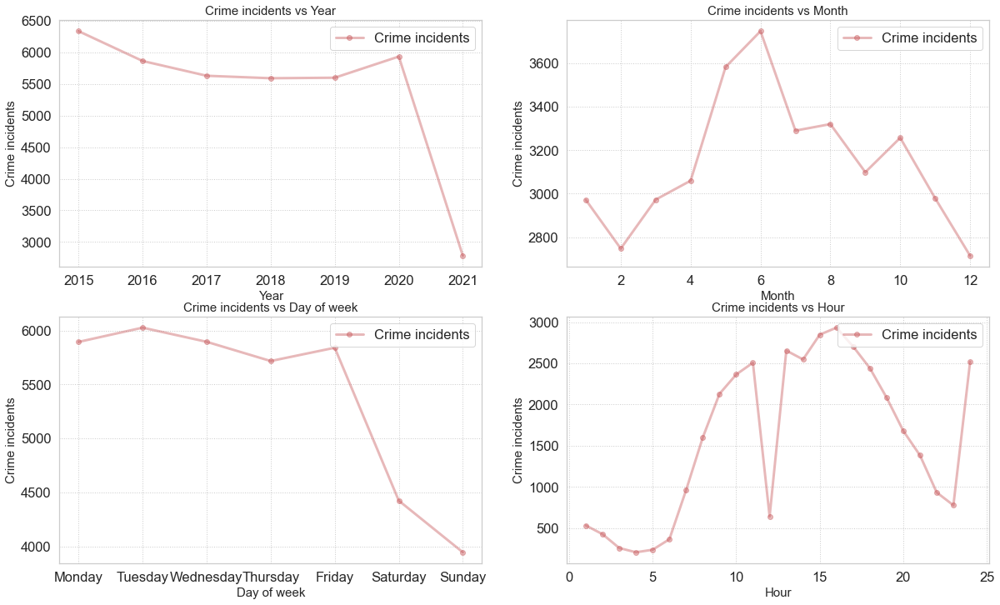

In [61]:
#df_cambridge.groupby(["Crime"]).agg({'File Number':['count']})

yearly_df_cam = df_cambridge.groupby(["year"]).agg({'File Number':['count']}).reset_index()
yearly_df_cam.columns=['year', 'incidents']

month_df_cam = df_cambridge.groupby(["month"]).agg({'File Number':['count']}).reset_index()
month_df_cam.columns=['month', 'incidents']

day_df_cam = df_cambridge.groupby(["dow"]).agg({'File Number':['count']}).reset_index()
day_df_cam.columns=['dow', 'incidents']
days = {0: 'Monday',1:'Tuesday', 2:'Wednesday', 3:'Thursday', 4:'Friday', 5:'Saturday', 6:'Sunday'}
day_df_cam['day_of_week'] = day_df_cam['dow'].apply(lambda x: days[x])
day_df_cam = day_df_cam.sort_values(by=['dow'])

hourly_df_cam = df_cambridge.groupby(["hour"]).agg({'File Number':['count']}).reset_index()
hourly_df_cam.columns=['hour', 'incidents']

# Plotting the charts
fig, ax = plt.subplots(2, 2, figsize=(20,12))

# Yearly chart
ax[0,0].plot(yearly_df_cam['year'], yearly_df_cam['incidents'], 'o-', label = 'Crime incidents', linewidth=3, color='r', alpha=0.4)
ax[0,0].set_xlabel("Year", fontsize = 15)
ax[0,0].set_ylabel("Crime incidents", fontsize = 15)
ax[0,0].grid(ls=':')
ax[0,0].legend(loc='upper right')
ax[0,0].set_title("Crime incidents vs Year", fontsize = 15)

# Monthly chart
ax[0,1].plot(month_df_cam['month'], month_df_cam['incidents'], 'o-', label = 'Crime incidents', linewidth=3, color='r', alpha=0.4)
ax[0,1].set_xlabel("Month", fontsize = 15)
ax[0,1].set_ylabel("Crime incidents", fontsize = 15)
ax[0,1].grid(ls=':')
ax[0,1].legend(loc='upper right')
ax[0,1].set_title("Crime incidents vs Month", fontsize = 15)

# Day of week chart
ax[1,0].plot(day_df_cam['day_of_week'], day_df_cam['incidents'], 'o-', label = 'Crime incidents', linewidth=3, color='r', alpha=0.4)
ax[1,0].set_xlabel("Day of week", fontsize = 15)
ax[1,0].set_ylabel("Crime incidents", fontsize = 15)
ax[1,0].grid(ls=':')
ax[1,0].legend(loc='upper right')
ax[1,0].set_title("Crime incidents vs Day of week", fontsize = 15)

# Day of hour chart
ax[1,1].plot(hourly_df_cam['hour'], hourly_df_cam['incidents'], 'o-', label = 'Crime incidents', linewidth=3, color='r', alpha=0.4)
ax[1,1].set_xlabel("Hour", fontsize = 15)
ax[1,1].set_ylabel("Crime incidents", fontsize = 15)
ax[1,1].grid(ls=':')
ax[1,1].legend(loc='upper right')
ax[1,1].set_title("Crime incidents vs Hour", fontsize = 15)

plt.show()


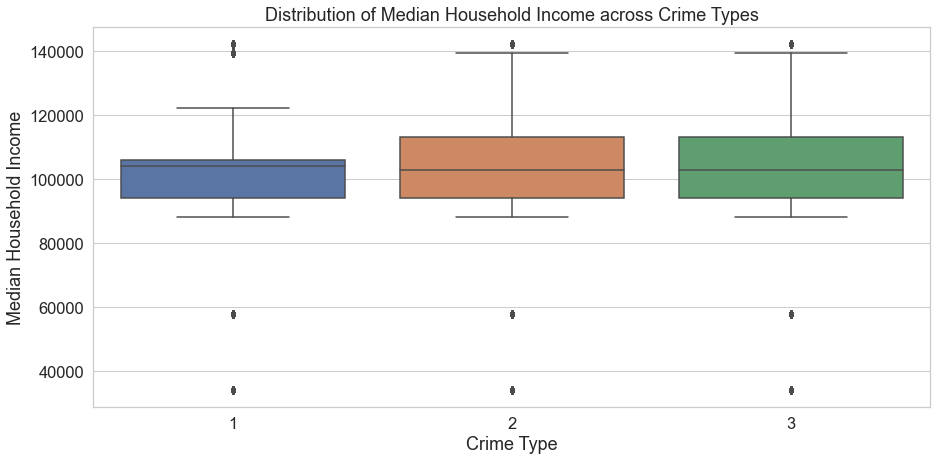

In [62]:
sns.set(rc={'figure.figsize':(15, 7)}, font_scale=1.5)
sns.set_style("whitegrid")
median_income_df = df_cambridge[["median_household_income", "crime_type"]]

median_plot = sns.boxplot(
    data=median_income_df,
    x="crime_type",
    y="median_household_income"
)

median_plot.set(
    xlabel="Crime Type",
    ylabel="Median Household Income",
    title="Distribution of Median Household Income across Crime Types"
)

plt.show()

### Data pre-processing

In [63]:
# Feature Engineering

model_df_ca = df_cambridge.copy()

# 6 Hour bands (24 hours is divided in 4 equal segments)
model_df_ca['hour_band'] = model_df_ca['hour']//6

# Holidays and weekend
model_df_ca['is_weekend'] = (pd.to_datetime(model_df_ca['DATE']).dt.dayofweek)//5

# One hot encoding for MONTH and hour_band
model_df_ca = pd.get_dummies(model_df_ca, columns = ['month', 'hour_band'], drop_first=True)

# Defined predictors (for base model, will be enhanced later)
predictors_ca = ['AWND', 'PRCP', 'SNOW', 'TAVG', 'TMAX', 'TMIN', 'is_weekend', 
              'month_2.0', 'month_3.0', 'month_4.0', 'month_5.0', 'month_6.0', 'month_7.0', 
              'month_8.0', 'month_9.0', 'month_10.0', 'month_11.0', 'month_12.0', 'hour_band_1.0', 
              'hour_band_2.0', 'hour_band_3.0','population', 'median_home_value', 'median_rent', 
              'percent_fam_with_children', 'percent_female', 'percent_below_10_years', 'percent_10_17_years', 
              'percent_18_24_years', 'percent_25_34_years', 'percent_35_44_years', 'percent_45_54_years', 
              'percent_55_64_years', 'percent_above_65_years', 'median_household_income', '0_25_percent', 
              '25_44_percent', '45_74_percent', '75_149_percent', '150_plus_percent', 'percent_less_than_hs',
              'percent_highschool', 'percent_some_college', 'percent_bachelor', 'percent_master_above', 
              'housing_percent_owner_occupied', 'housing_percent_renter_occupied', 'percent_white', 
              'percent_black', 'percent_hispanic', 'percent_asian', 'percent_other_race']

# Get predictor and response variables
X_ca = model_df_ca[predictors_ca]
y_ca = model_df_ca[response]

# Train test split (80 - 20 split)
X_train_ca, X_test_ca, y_train_ca, y_test_ca = train_test_split(X_ca, y_ca, train_size=0.8, random_state=random_state, stratify=model_df_ca["crime_type"])

# Scaled data
scaler = StandardScaler().fit(X_train_ca)
X_train_scaled_ca = pd.DataFrame(scaler.transform(X_train_ca), index = X_train_ca.index, columns = predictors_ca)
X_test_scaled_ca = pd.DataFrame(scaler.transform(X_test_ca), index = X_test_ca.index, columns = predictors_ca)

### Naive model

In [64]:
# Naive model accuracy (preedicting everything as type_3)

naive_accuracy = model_df_ca[model_df_ca['crime_type']==3].shape[0] / model_df_ca.shape[0]

print(f"Naive model accuracy is :{naive_accuracy:.4f}")

Naive model accuracy is :0.4750


### Logistic Regression

The result below shows a low accuracy from the model similar to the naive model. Here we have similar issue to Boston beacause the majority of predictors are at neighborhood level and hence there are very few distinct datapoints. Additionally, Cambridge is a smaller city and unlike Boston that has neighborhoods with very different socio-economic aspects, most of Cambridge neighborhoods are very similar in those aspects which make the predicors not as useful.


==========================================CONFUSION MATRIX============================================

[[  13    0 2338]
 [   7    0 1605]
 [   5    0 3581]]

=========================================CLASSIFICATION REPORT=========================================

              precision    recall  f1-score   support

           1      0.520     0.006     0.011      2351
           2      0.000     0.000     0.000      1612
           3      0.476     0.999     0.645      3586

    accuracy                          0.476      7549
   macro avg      0.332     0.335     0.219      7549
weighted avg      0.388     0.476     0.310      7549


==========================================ACCURACY AND AUC============================================

Accuracy (Train) from Logistic model is: 0.4754
Accuracy from Logistic model is: 0.4761
AUC score from Logistic model is: 0.5459




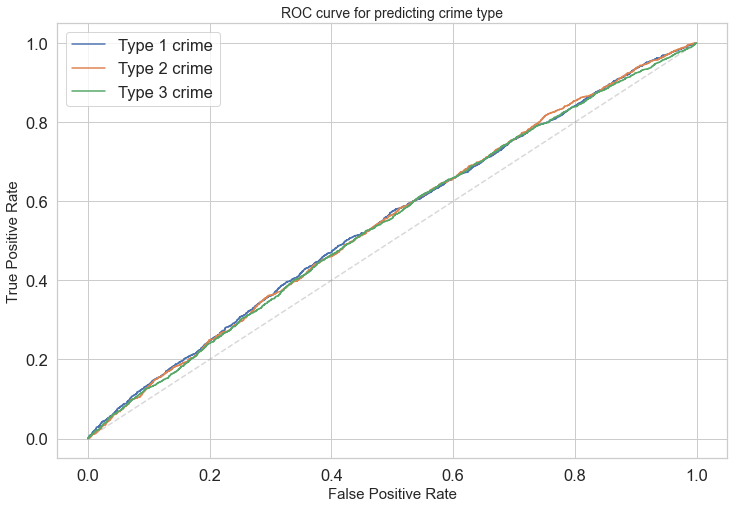

run time: 1.7 seconods


In [65]:
start_time = time.time()

y_pred_train_ca, y_pred_test_ca, y_proba_train_ca, y_proba_test_ca, model_ca = util.build_logistic_reg(X_train_scaled_ca, y_train_ca, X_test_scaled_ca, y_test_ca)

util.make_roc_plot(y_test_ca, y_proba_test_ca)

print(f"run time: {(time.time() - start_time):.1f} seconods")

In [66]:
util.display_betas(X_train_ca, model_ca)




Logistic Regression Estimated Betas:

	intercept                           (β0)   	-0.0167		-0.3953		0.4120
	AWND                                (β1)   	0.0034		-0.0113		0.0080
	PRCP                                (β2)   	-0.0105		0.0077		0.0028
	SNOW                                (β3)   	-0.0127		-0.0010		0.0137
	TAVG                                (β4)   	-0.0395		-0.0268		0.0663
	TMAX                                (β5)   	0.0448		0.0112		-0.0559
	TMIN                                (β6)   	0.0023		0.0295		-0.0318
	is_weekend                          (β7)   	0.0692		-0.1002		0.0309
	month_2.0                           (β8)   	-0.0282		0.0101		0.0182
	month_3.0                           (β9)   	-0.0270		0.0102		0.0168
	month_4.0                           (β10)   	0.0114		-0.0150		0.0036
	month_5.0                           (β11)   	-0.0097		-0.0074		0.0172
	month_6.0                           (β12)   	0.0147		-0.0098		-0.0049
	month_7.0                           (β13)   	0.0193		

## End of Notebook